In [1]:
import deepchem as dc
import numpy as np
from numpy import genfromtxt
import pandas as pd
#SKLearn
import sklearn
from sklearn.linear_model import Lasso,ElasticNetCV, LinearRegression,LassoCV
from sklearn.tree import DecisionTreeRegressor
from sklearn import model_selection
from sklearn.gaussian_process.kernels import ConstantKernel, RBF,Matern,RationalQuadratic
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import BaggingRegressor,GradientBoostingRegressor,RandomForestRegressor
from sklearn import preprocessing
from sklearn.gaussian_process import GaussianProcessRegressor
#RDKit
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit.Chem.Draw import IPythonConsole
from rdkit.Chem import Draw
from rdkit.Chem.Draw import DrawingOptions
from rdkit.Chem import Descriptors, rdMolDescriptors
from rdkit.Chem import Crippen
from rdkit.ML.Cluster import Butina
from rdkit import DataStructs
#Matplotlib
import matplotlib. pyplot as plt
from matplotlib_venn import venn3, venn3_circles
from matplotlib_venn import venn2, venn2_circles
# Logging
import logging 
logging.basicConfig(format='%(message)s')
log = logging.getLogger()
log.setLevel(logging.INFO)
#Seaborn
import seaborn as sns

# Loading Data

In [2]:
data = pd.read_csv("../dataset_ise.csv", encoding='utf-8')
data.columns = ["_".join(ent.lower().strip().split(" ")) for ent in data.columns]

In [3]:
data['target'] = np.log10(data['ec50_/_mol%'])

In [4]:
data

,entry_in_paper,smiles,anion,binding_mode\n(transporter),binding_mode\n(anion),stochiometry\n(#_of_anion_\nper_transporter),nmr_solvent,ka_(_m-1),unnamed:_8,log(ka),...,backup_ec50_/_mol%,ec50_/_mol%,unnamed:_21,target,hill_parameter_n,unnamed:_24,paperid,year,ref,unnamed:_28
0,1,S=C(NCCCCCC)NC1=CC=C(Br)C=C1,Cl,1.0,1.0,1.0,DMSO,18.62,NaN,1.27,...,0.93,0.93,0.18,-0.031517,NaN,NaN,1,2013,Towards predictable transmembrane transport: Q...,NaN
1,2,S=C(NCCCCCC)NC1=CC=C(C(F)(F)F)C=C1,Cl,1.0,1.0,1.0,DMSO,26.30,NaN,1.42,...,0.44,0.44,0.04,-0.356547,1.65,0.08,1,2013,Towards predictable transmembrane transport: Q...,NaN
2,3,S=C(NCCCCCC)NC1=CC=C(Cl)C=C1,Cl,1.0,1.0,1.0,DMSO,19.95,NaN,1.30,...,1.02,1.02,0.21,0.008600,1.57,0.19,1,2013,Towards predictable transmembrane transport: Q...,NaN
3,4,S=C(NCCCCCC)NC1=CC=C(C#N)C=C1,Cl,1.0,1.0,1.0,DMSO,31.62,NaN,1.50,...,0.82,0.82,0.17,-0.086186,2.11,0.13,1,2013,Towards predictable transmembrane transport: Q...,NaN
4,5,S=C(NCCCCCC)NC1=CC=C(C(C(F)(F)F)=O)C=C1,Cl,1.0,1.0,1.0,DMSO,41.69,NaN,1.62,...,0.93,0.93,0.10,-0.031517,1.93,0.13,1,2013,Towards predictable transmembrane transport: Q...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
299,4,O=C1C(NC2=CC(C(C)(C)C)=CC(C(C)(C)C)=C2)=C(NC3=...,Cl,1.0,1.0,1.0,DMSO,145,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,33,2014,Thiosquaramides: pH switchable anion transport...,NaN
300,5,S=C1C(NC2=CC=CC=C2)=C(NC3=CC=CC=C3)C1=S,Cl,1.0,1.0,1.0,DMSO,270,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,33,2014,Thiosquaramides: pH switchable anion transport...,NaN
301,6,S=C1C(NC2=CC=C(C(F)(F)F)C=C2)=C(NC3=CC=C(C(F)(...,Cl,1.0,1.0,1.0,DMSO,60,NaN,NaN,...,0.68,0.68,NaN,-0.167491,NaN,NaN,33,2014,Thiosquaramides: pH switchable anion transport...,NaN
302,7,S=C1C(NC2=CC(C(F)(F)F)=CC(C(F)(F)F)=C2)=C(NC3=...,Cl,1.0,1.0,1.0,DMSO,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,33,2014,Thiosquaramides: pH switchable anion transport...,NaN


In [5]:
smiles = data['smiles']
smiles

0                           S=C(NCCCCCC)NC1=CC=C(Br)C=C1
1                     S=C(NCCCCCC)NC1=CC=C(C(F)(F)F)C=C1
2                           S=C(NCCCCCC)NC1=CC=C(Cl)C=C1
3                          S=C(NCCCCCC)NC1=CC=C(C#N)C=C1
4                S=C(NCCCCCC)NC1=CC=C(C(C(F)(F)F)=O)C=C1
                             ...                        
299    O=C1C(NC2=CC(C(C)(C)C)=CC(C(C)(C)C)=C2)=C(NC3=...
300              S=C1C(NC2=CC=CC=C2)=C(NC3=CC=CC=C3)C1=S
301    S=C1C(NC2=CC=C(C(F)(F)F)C=C2)=C(NC3=CC=C(C(F)(...
302    S=C1C(NC2=CC(C(F)(F)F)=CC(C(F)(F)F)=C2)=C(NC3=...
303    S=C1C(NC2=CC(C(C)(C)C)=CC(C(C)(C)C)=C2)=C(NC3=...
Name: smiles, Length: 304, dtype: object

In [12]:
target = data["target"]

# Drawing Molecules

Source: https://gist.github.com/adelenelai/beed325f06a23f7ebc491903f171757f

In [13]:
# Create RDKit molecular objects
mols = [Chem.MolFromSmiles(m) for m in smiles]

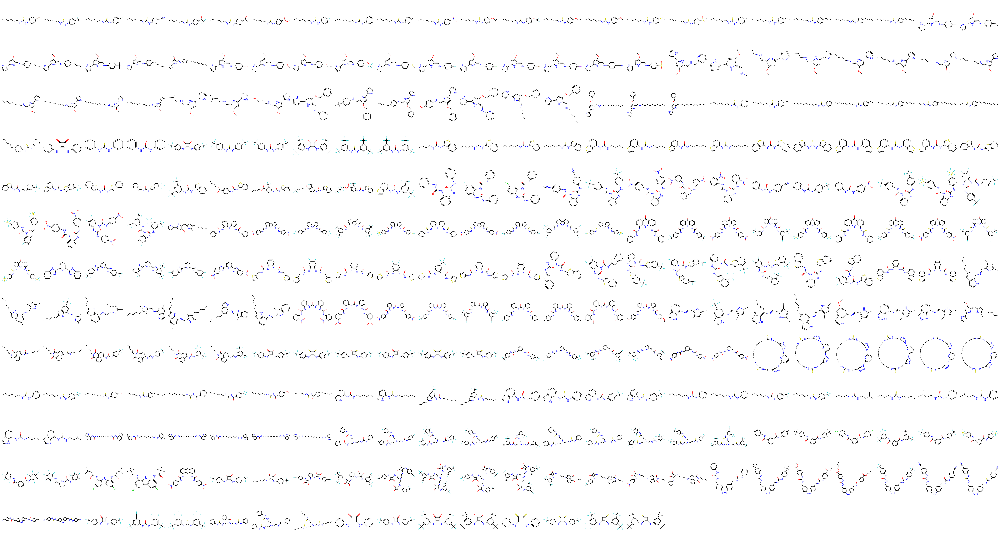

In [14]:
from rdkit.Chem.Draw import rdMolDraw2D
try:
    import Image
except ImportError:
    from PIL import Image
from io import BytesIO

def DrawMolsZoomed(mols, molsPerRow=3, subImgSize=(300, 300)):#, leg): #https://www.rdkit.org/docs/source/rdkit.Chem.Draw.rdMolDraw2D.html#rdkit.Chem.Draw.rdMolDraw2D.MolDraw2D
    nRows = len(mols) // molsPerRow
    if len(mols) % molsPerRow: nRows += 1
    fullSize = (molsPerRow * subImgSize[0], nRows * subImgSize[1])
    full_image = Image.new('RGBA', fullSize )
    for ii, mol in enumerate(mols):
        if mol.GetNumConformers() == 0:
            AllChem.Compute2DCoords(mol)
        column = ii % molsPerRow
        row = ii // molsPerRow
        offset = ( column*subImgSize[0], row * subImgSize[1] )
        d2d = rdMolDraw2D.MolDraw2DCairo(subImgSize[0], subImgSize[1])
        d2d.DrawMolecule(mol)
        d2d.FinishDrawing()
        sub = Image.open(BytesIO(d2d.GetDrawingText()))
        full_image.paste(sub,box=offset)
    return full_image

DrawMolsZoomed(mols, molsPerRow=24)

In [15]:
# with CoordGen
from rdkit.Chem import rdCoordGen
import os
try:
    import skunk
except ImportError:
    !pip install skunk
    import skunk

try:
    import cairosvg
except ImportError:
    !pip install cairosvg
    import cairosvg

    
def DrawMolsZoomed_UPGRADE(mols, outname='all_mols', shape=None, labels=None):
    svg_dir = "svg"
    if not os.path.exists(svg_dir):
        os.makedirs(svg_dir)

    for i, mol in enumerate(mols):
        drawer = rdMolDraw2D.MolDraw2DSVG(300,300)
        drawer.drawOptions().addStereoAnnotation = False
        rdCoordGen.AddCoords(mol)
        drawer.DrawMolecule(mol)
        drawer.FinishDrawing()
        svg1 = drawer.GetDrawingText()
        with open(os.path.join(svg_dir, f"{i}.svg"), "w") as f:
            f.write(svg1)

    svg_files = [os.path.join(svg_dir, f"{i}.svg") for i in range(len(mols))]

    svg = skunk.layout_svgs(svgs=svg_files, labels=labels, shape=shape)
    skunk.display(svg) 

    # write to file
    with open(f'{outname}.svg', "w") as f:
        f.write(svg)

    cairosvg.svg2pdf(bytestring=svg, write_to=f'{outname}.pdf')



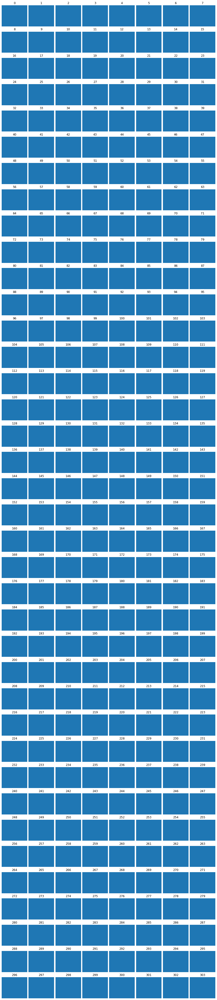

In [16]:
labels = [f"{i}" for i in range(len(mols))]
DrawMolsZoomed_UPGRADE(mols, outname='all_mols', shape=(38, 8), labels=labels)

# Substructure Matching

In [17]:
def get_match(patterm_mol, mols):
    matches = []
    indices = []

    patt = patterm_mol
    for i, mol in enumerate(mols):
        if mol.HasSubstructMatch(patt):
            indices.append(i)
            matches.append(mol)
    return matches, indices

## Thioureas

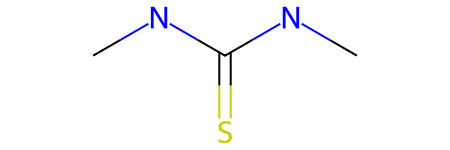

In [18]:
patt_thiourea = Chem.MolFromSmarts(Chem.MolToSmarts(Chem.MolFromSmiles('S=C(NC)NC')))
patt_thiourea

86


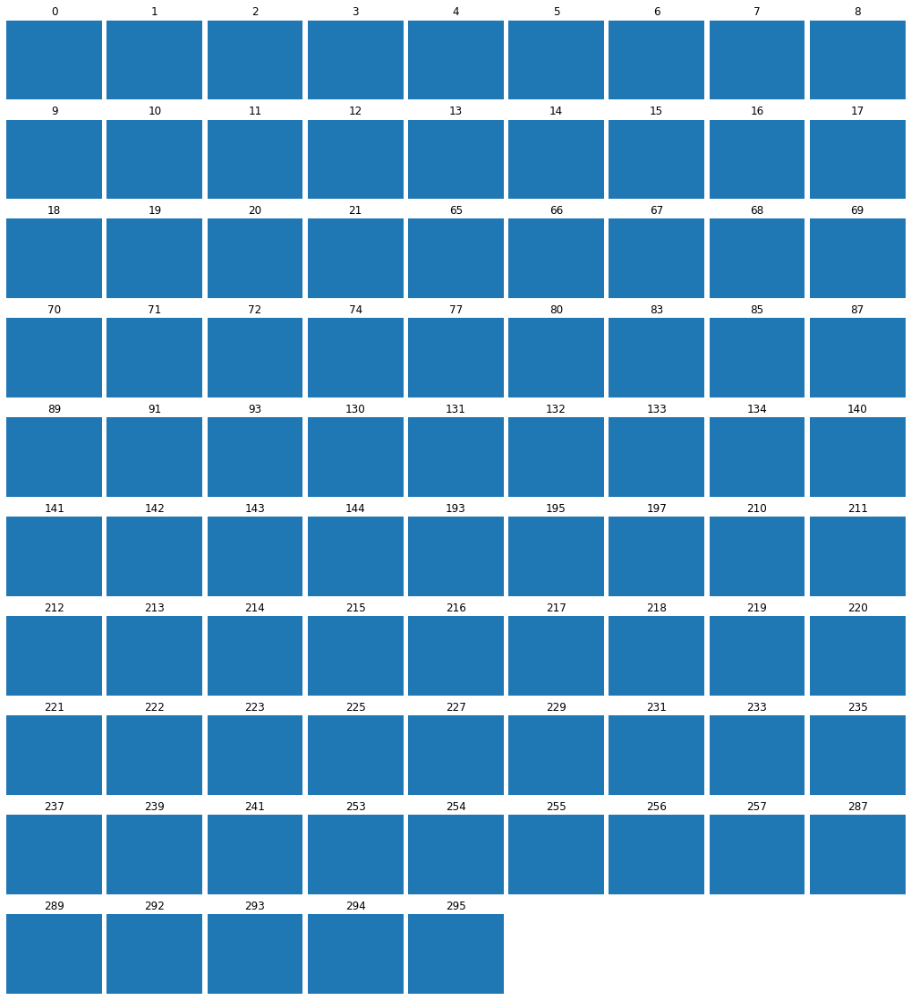

In [19]:
matches_thiourea, indices_thiourea = get_match(patt_thiourea, mols)
print(len(matches_thiourea))
DrawMolsZoomed_UPGRADE(matches_thiourea, outname='all_thiourea_mols', shape=None, labels=indices_thiourea)

## Urea

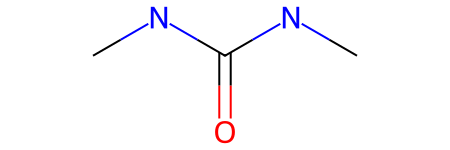

In [20]:
patt_urea = Chem.MolFromSmarts(Chem.MolToSmarts(Chem.MolFromSmiles('O=C(NC)NC')))
patt_urea

113


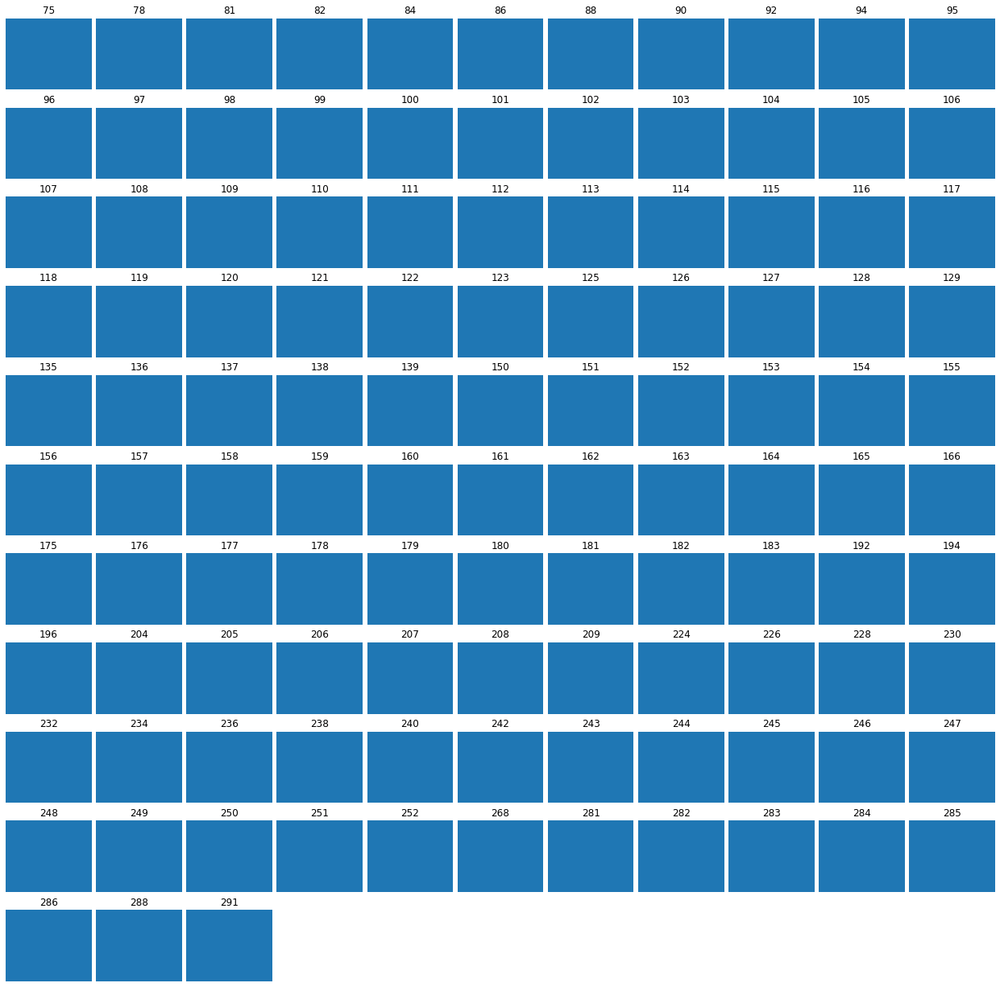

In [21]:
matches_urea, indices_urea = get_match(patt_urea, mols)
print(len(matches_urea))
DrawMolsZoomed_UPGRADE(matches_urea, outname='all_urea_mols', shape=None, labels=indices_urea)

## Squaramide

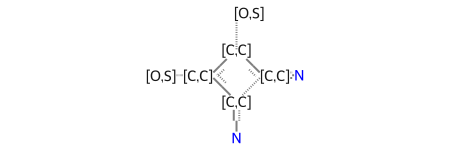

In [22]:
patt_squara = Chem.MolFromSmarts('N[C,c]1~[C,c](N)[C,c]([C,c]1~[O,S])~[O,S]')
patt_squara

30


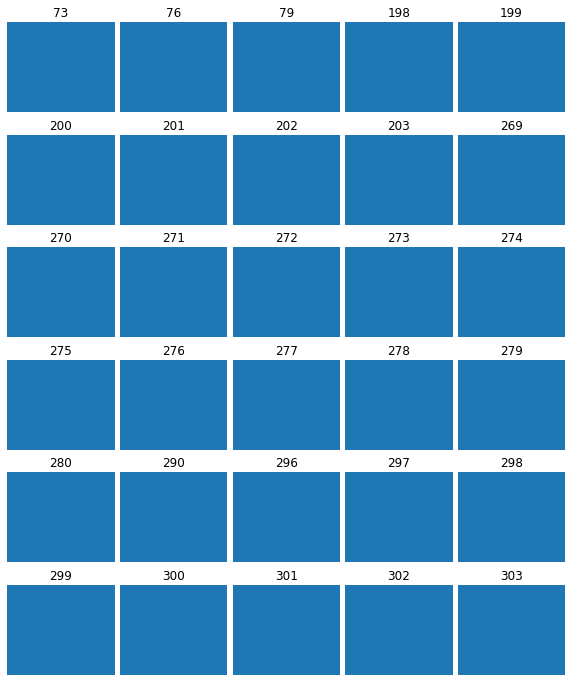

In [23]:
matches_squara, indices_squara = get_match(patt_squara, mols)
print(len(matches_squara))
DrawMolsZoomed_UPGRADE(matches_squara, outname='all_squara_mols', shape=None, labels=indices_squara)

## Tambjamine

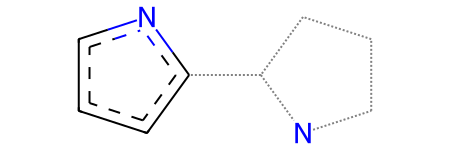

In [24]:
patt_tamb = Chem.MolFromSmarts('[#6]1~[#6]~[#6]~[#6](~[#6]2:[#6]:[#6]:[#6]:[#7H]:2)~[#7]~1')
patt_tamb

45


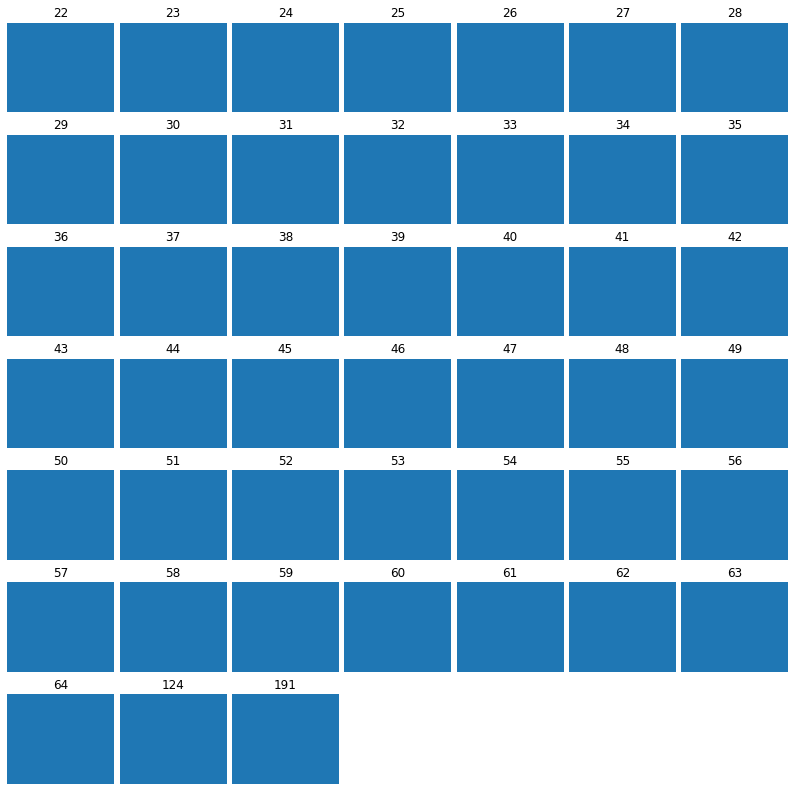

In [25]:
matches_tamb, indices_tamb = get_match(patt_tamb, mols)
print(len(matches_tamb))
DrawMolsZoomed_UPGRADE(matches_tamb, outname='all_tamb_mols', shape=None, labels=indices_tamb)


## Carbazole

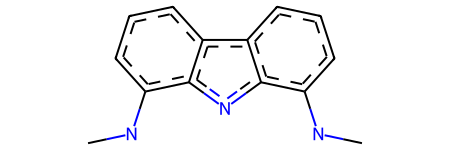

In [26]:
patt_carbazole = Chem.MolFromSmarts(Chem.MolToSmarts(Chem.MolFromSmiles('CNC1=CC=CC2=C1NC3=C2C=CC=C3NC')))
patt_carbazole

12


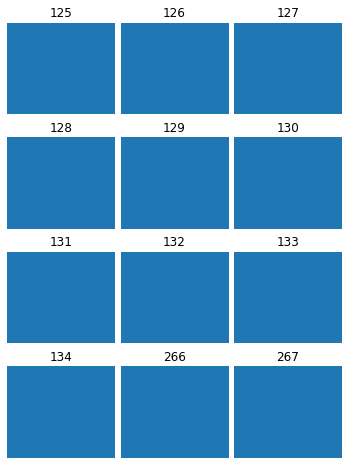

In [27]:
matches_carbazole, indices_carbazole = get_match(patt_carbazole, mols)
print(len(matches_carbazole))
DrawMolsZoomed_UPGRADE(matches_carbazole, outname='all_carbazole_mols', shape=None, labels=indices_carbazole)

## Perenosin

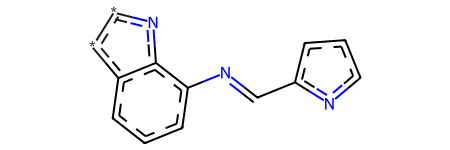

In [28]:
patt_pere = Chem.MolFromSmarts('[#6]12:[*]:[*]:[#7H]:[#6]:1:[#6](/[#7]=[#6]/[#6]1:[#6]:[#6]:[#6]:[#7H]:1):[#6]:[#6]:[#6]:2')
patt_pere

15


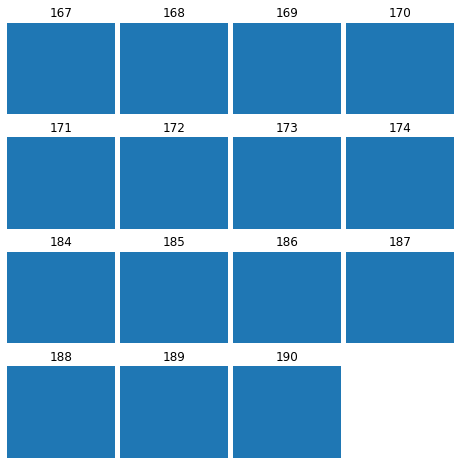

In [29]:
matches_pere, indices_pere = get_match(patt_pere, mols)
print(len(matches_pere))
DrawMolsZoomed_UPGRADE(matches_pere, outname='all_pere_mols', shape=None, labels=indices_pere)

## Indole

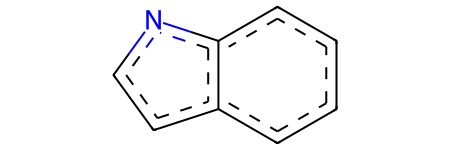

In [30]:
patt_indole = Chem.MolFromSmarts(Chem.MolToSmarts(Chem.MolFromSmiles('C1(C=CC=C2)=C2NC=C1')))
patt_indole

41


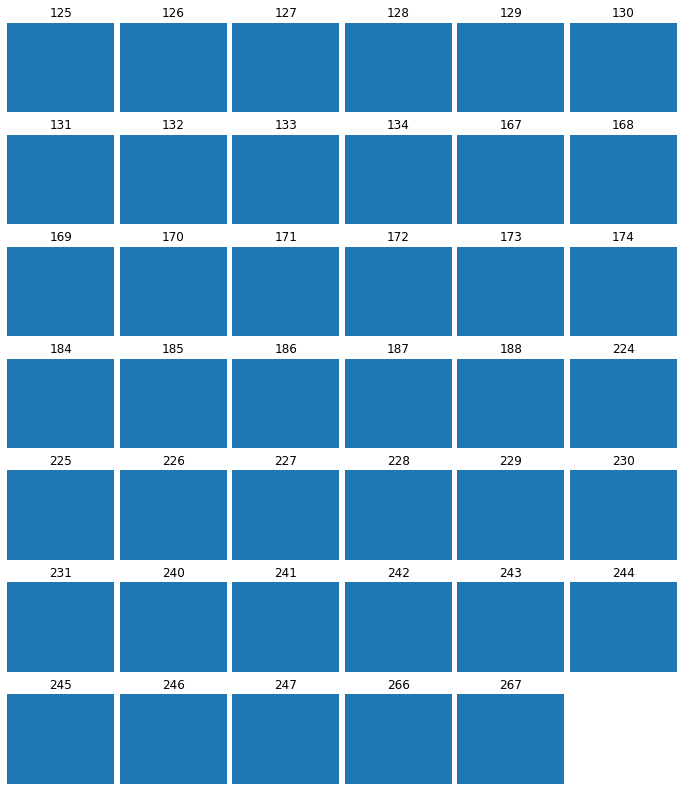

In [31]:
matches_indole, indices_indole = get_match(patt_indole, mols)
print(len(matches_indole))
DrawMolsZoomed_UPGRADE(matches_indole, outname='all_indole_mols', shape=None, labels=indices_indole)

## Acridinone

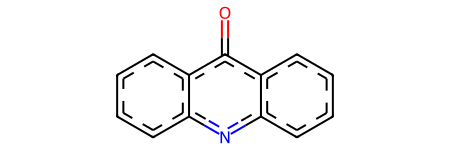

In [32]:
patt_acridinone = Chem.MolFromSmarts(Chem.MolToSmarts(Chem.MolFromSmiles('O=C1C2=C(C=CC=C2)NC3=C1C=CC=C3')))
patt_acridinone

10


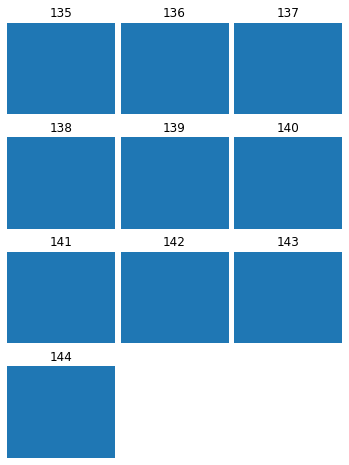

In [33]:
matches_acridinone, indices_acridinone = get_match(patt_acridinone, mols)
print(len(matches_acridinone))
DrawMolsZoomed_UPGRADE(matches_acridinone, outname='all_acridinone_mols', shape=None, labels=indices_acridinone)

## 1,3-bis(benzimidazol-2-yl)pyrimidine (BisBzImPy)

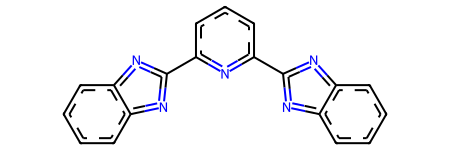

In [34]:
patt_BBP = Chem.MolFromSmarts(Chem.MolToSmarts(Chem.MolFromSmiles('C1(C2=NC(C=CC=C3)=C3N2)=CC=CC(C4=NC5=C(C=CC=C5)N4)=N1')))
patt_BBP

5


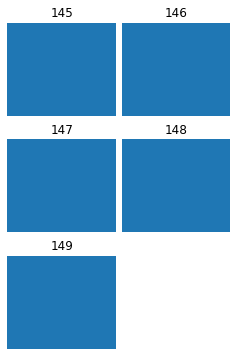

In [35]:
matches_BBP, indices_BBP = get_match(patt_BBP, mols)
print(len(matches_BBP))
DrawMolsZoomed_UPGRADE(matches_BBP, outname='all_BBP_mols', shape=None, labels=indices_BBP)

## isophthalamides/dipicolineamides

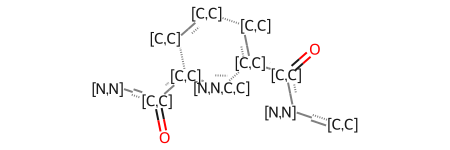

In [36]:
patt_isop_dipico = Chem.MolFromSmarts('O=[C,c]([N,n][C,c])[C,c]1~[N,n,C,c][C,c]([C,c]([N,n])=O)~[C,c][C,c]~[C,c]1')
patt_isop_dipico

8


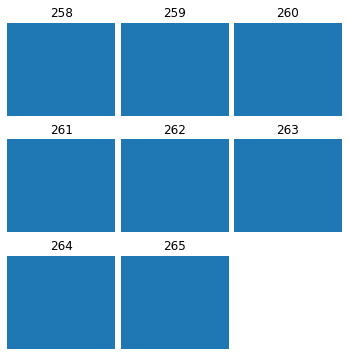

In [37]:
matches_isop_dipico, indices_isop_dipico = get_match(patt_isop_dipico, mols)
print(len(matches_isop_dipico))
DrawMolsZoomed_UPGRADE(matches_isop_dipico, outname='all_isop_dipico_mols', shape=None, labels=indices_isop_dipico)

# Find overlap between substructure datasets

In [38]:
# Disctionary: substructure pattern : list of RDKit molecules
substructure_dict = {'thiourea': matches_thiourea, 
                     'urea': matches_urea, 
                     'squaramide': matches_squara, 
                     'indole': matches_indole, 
                     'tambjamine': matches_tamb, 
                     'carbazole': matches_carbazole, 
                     'acridinone': matches_acridinone, 
                     'perenosin': matches_pere,
                     'BisBzImPy': matches_BBP, 
                     'isophthalamides/dipicolineamides': matches_isop_dipico}

In [39]:
print('Substructure', '#molecules')
for n, l in substructure_dict.items():
    print(n, len(l))
    substructure_set = set(l)

Substructure #molecules
thiourea 86
urea 113
squaramide 30
indole 41
tambjamine 45
carbazole 12
acridinone 10
perenosin 15
BisBzImPy 5
isophthalamides/dipicolineamides 8


In [40]:
# List of substructure patterns from SMARTS
substructure_core_list = [patt_thiourea, 
                         patt_urea, 
                         patt_squara, 
                         patt_indole, 
                         patt_tamb, 
                         patt_carbazole, 
                         patt_acridinone, 
                         patt_pere,
                         patt_BBP, 
                         patt_isop_dipico]

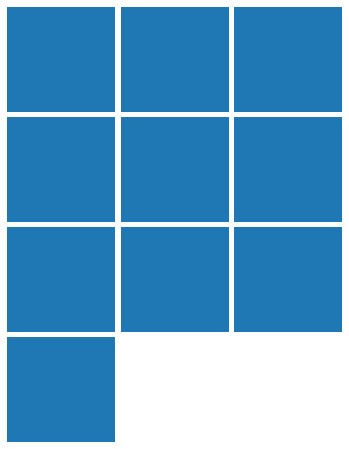

In [41]:
DrawMolsZoomed_UPGRADE(substructure_core_list, outname='all_substructure_cores', shape=None, labels=None)

In [42]:
# List of substructure names
substructure_name_list = ['thiourea',
                     'urea', 
                     'squaramide', 
                     'indole', 
                     'tambjamine', 
                     'carbazole', 
                     'acridinone', 
                     'perenosin',
                     'BisBzImPy', 
                     'isophthalamides/dipicolineamides']
n_substructure = len(substructure_name_list)

In [43]:
# Convert list of RDKit molecules to list to canonical smiles
matches_thiourea_smi = [Chem.MolToSmiles(m) for m in matches_thiourea]
matches_urea_smi = [Chem.MolToSmiles(m) for m in matches_urea]
matches_squara_smi = [Chem.MolToSmiles(m) for m in matches_squara]
matches_indole_smi = [Chem.MolToSmiles(m) for m in matches_indole]
matches_tamb_smi = [Chem.MolToSmiles(m) for m in matches_tamb]
matches_carbazole_smi = [Chem.MolToSmiles(m) for m in matches_carbazole]
matches_acridinone_smi = [Chem.MolToSmiles(m) for m in matches_acridinone]
matches_pere_smi = [Chem.MolToSmiles(m) for m in matches_pere]
matches_BBP_smi = [Chem.MolToSmiles(m) for m in matches_BBP]
matches_isop_dipico_smi = [Chem.MolToSmiles(m) for m in matches_isop_dipico]

# List of lists of smiles with each substructure pattern
substructure_smi_list = [matches_thiourea_smi, 
                         matches_urea_smi, 
                         matches_squara_smi, 
                         matches_indole_smi, 
                         matches_tamb_smi, 
                         matches_carbazole_smi, 
                         matches_acridinone_smi, 
                         matches_pere_smi,
                         matches_BBP_smi, 
                         matches_isop_dipico_smi]

In [44]:
# Convert list of lists of smiles with each substructure pattern 
#to a list of sets of smiles with each substructure pattern
substructure_set_list = []
for i in range(n_substructure):
    substructure_set_list.append(set(substructure_smi_list[i]))

In [45]:
#intersect03 = substructure_set_list[0].intersection(substructure_set_list[3])
#print(intersect03)
#venn2([substructure_set_list[0], substructure_set_list[3]], (substructure__name_list[0], substructure_name_list[3]))

In [46]:
smiles_canonical = [Chem.MolToSmiles(m) for m in mols]

Intersect b/t thiourea and urea: 0

----------------------------------------------------------------------------------------
Intersect b/t thiourea and squaramide: 0

----------------------------------------------------------------------------------------
Intersect b/t thiourea and indole: 10

Index of overlapped molecules:  [231, 133, 130, 225, 132, 134, 241, 229, 131, 227]


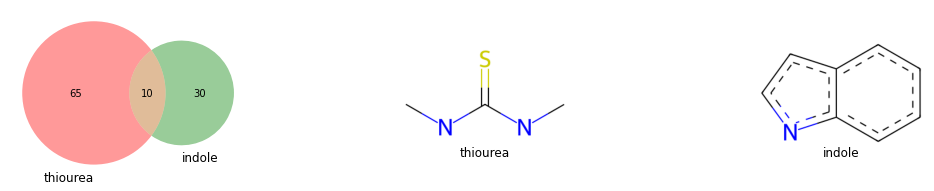

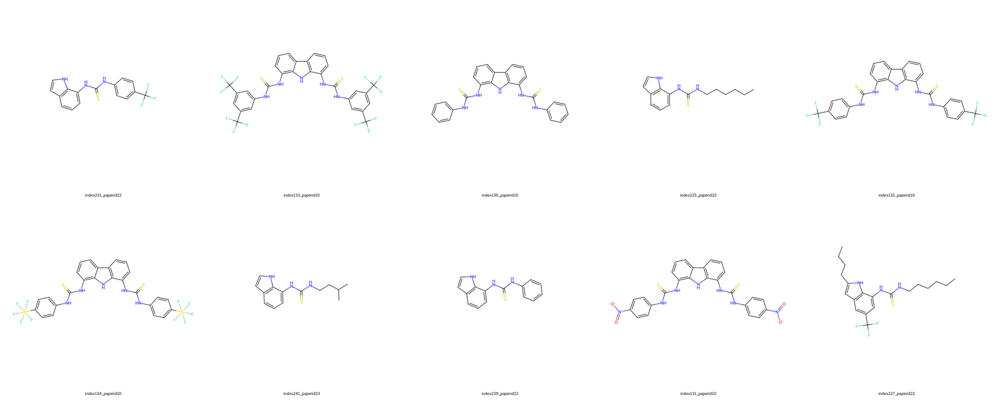

----------------------------------------------------------------------------------------
Intersect b/t thiourea and tambjamine: 0

----------------------------------------------------------------------------------------
Intersect b/t thiourea and carbazole: 5

Index of overlapped molecules:  [130, 133, 132, 134, 131]


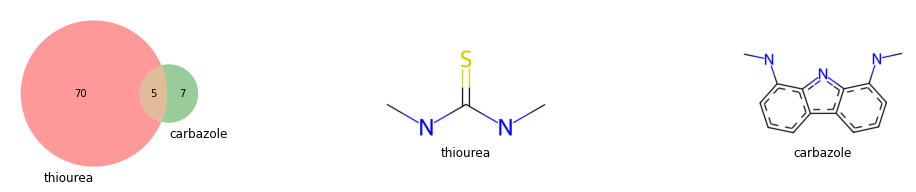

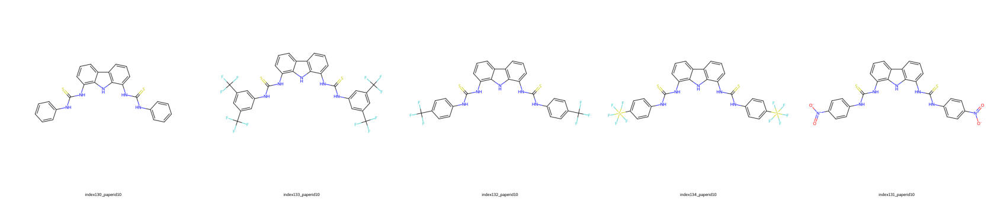

----------------------------------------------------------------------------------------
Intersect b/t thiourea and acridinone: 5

Index of overlapped molecules:  [143, 140, 142, 144, 141]


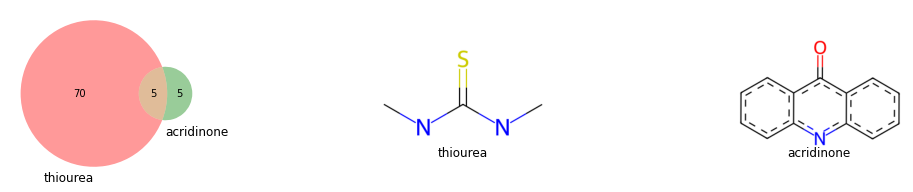

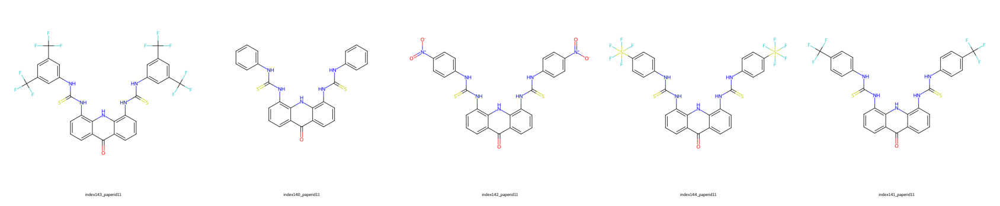

----------------------------------------------------------------------------------------
Intersect b/t thiourea and perenosin: 0

----------------------------------------------------------------------------------------
Intersect b/t thiourea and BisBzImPy: 0

----------------------------------------------------------------------------------------
Intersect b/t thiourea and isophthalamides/dipicolineamides: 0

----------------------------------------------------------------------------------------
Intersect b/t urea and squaramide: 0

----------------------------------------------------------------------------------------
Intersect b/t urea and indole: 16

Index of overlapped molecules:  [224, 126, 125, 230, 228, 240, 246, 243, 129, 128, 127, 244, 245, 247, 242, 226]


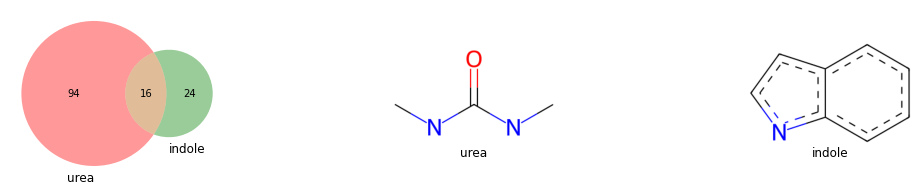

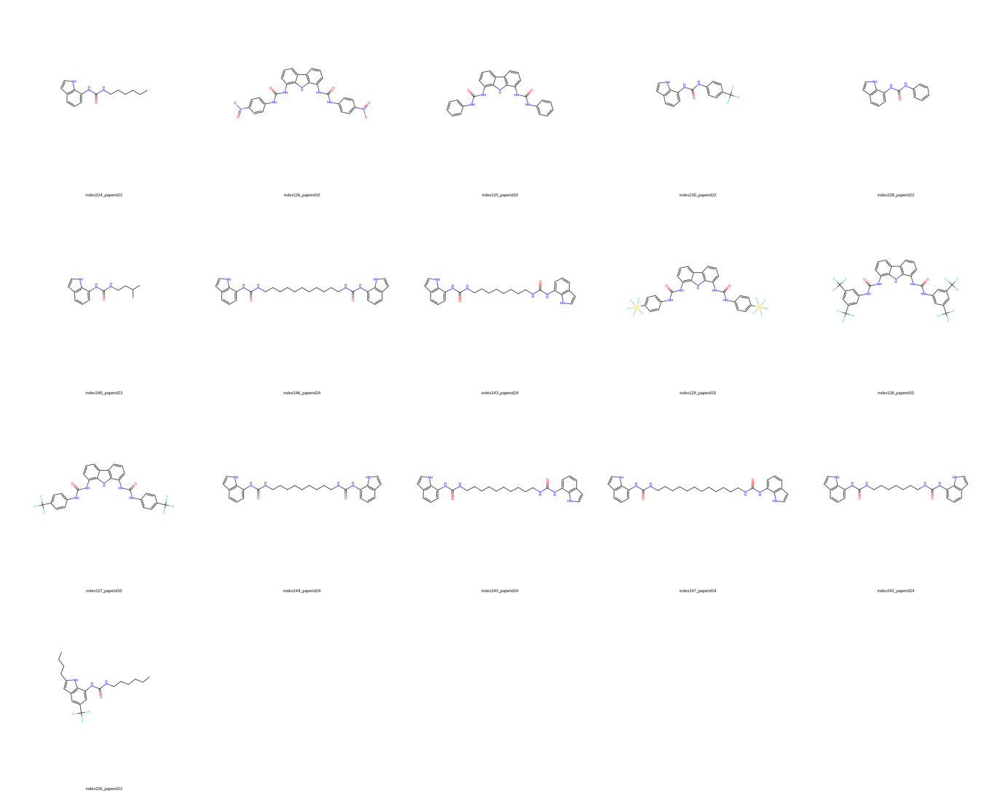

----------------------------------------------------------------------------------------
Intersect b/t urea and tambjamine: 0

----------------------------------------------------------------------------------------
Intersect b/t urea and carbazole: 5

Index of overlapped molecules:  [126, 129, 128, 127, 125]


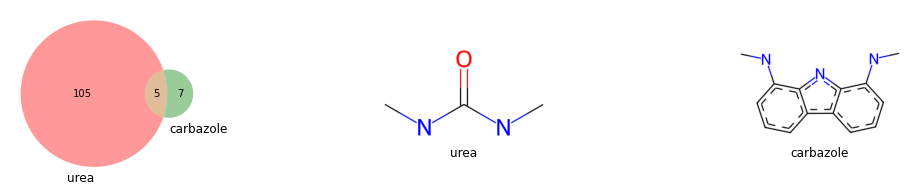

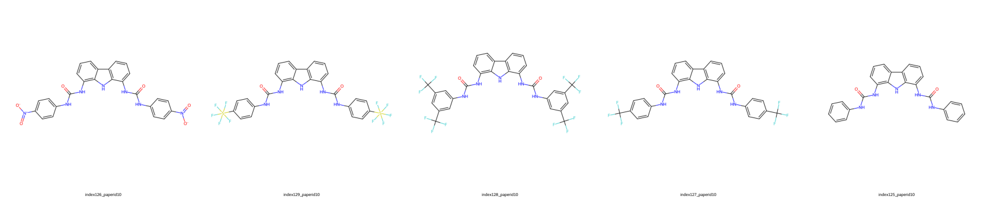

----------------------------------------------------------------------------------------
Intersect b/t urea and acridinone: 5

Index of overlapped molecules:  [138, 137, 136, 135, 139]


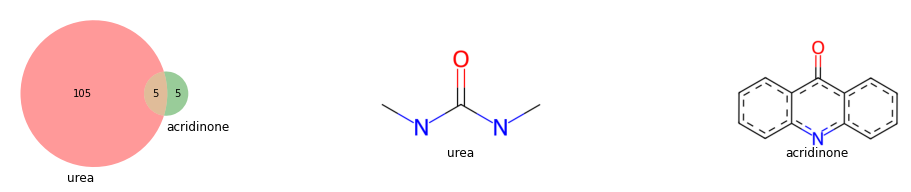

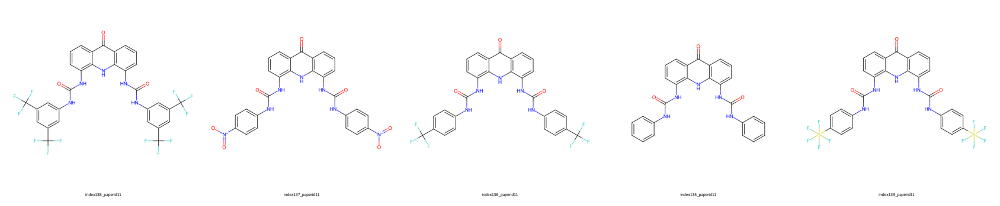

----------------------------------------------------------------------------------------
Intersect b/t urea and perenosin: 0

----------------------------------------------------------------------------------------
Intersect b/t urea and BisBzImPy: 0

----------------------------------------------------------------------------------------
Intersect b/t urea and isophthalamides/dipicolineamides: 0

----------------------------------------------------------------------------------------
Intersect b/t squaramide and indole: 0

----------------------------------------------------------------------------------------
Intersect b/t squaramide and tambjamine: 0

----------------------------------------------------------------------------------------
Intersect b/t squaramide and carbazole: 0

----------------------------------------------------------------------------------------
Intersect b/t squaramide and acridinone: 0

------------------------------------------------------------------------

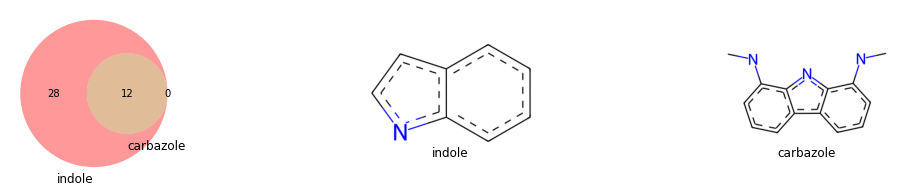

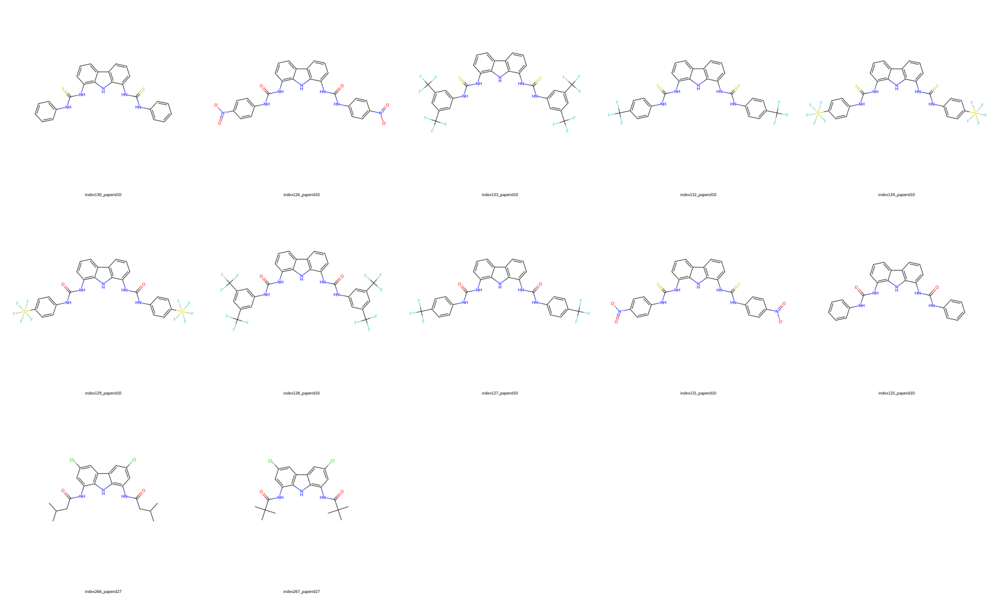

----------------------------------------------------------------------------------------
Intersect b/t indole and acridinone: 0

----------------------------------------------------------------------------------------
Intersect b/t indole and perenosin: 12

Index of overlapped molecules:  [174, 186, 170, 172, 171, 169, 185, 188, 167, 168, 173, 184]


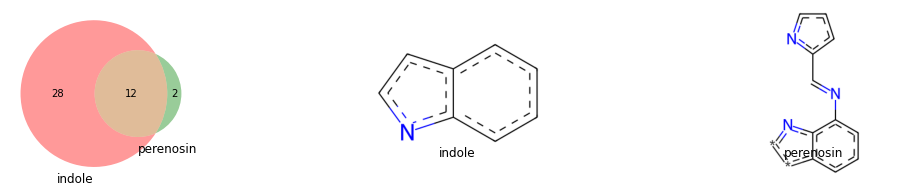

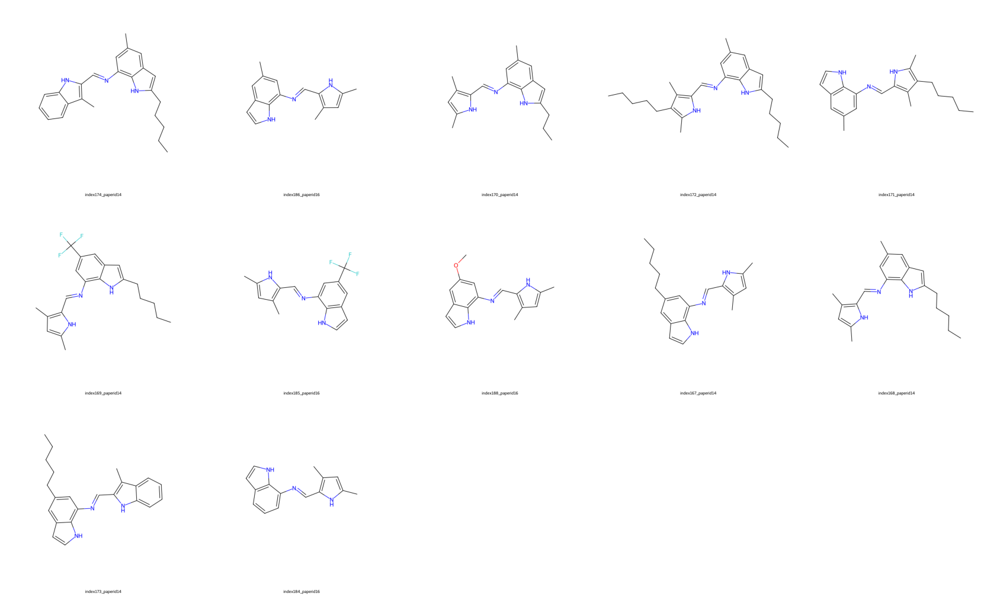

----------------------------------------------------------------------------------------
Intersect b/t indole and BisBzImPy: 0

----------------------------------------------------------------------------------------
Intersect b/t indole and isophthalamides/dipicolineamides: 0

----------------------------------------------------------------------------------------
Intersect b/t tambjamine and carbazole: 0

----------------------------------------------------------------------------------------
Intersect b/t tambjamine and acridinone: 0

----------------------------------------------------------------------------------------
Intersect b/t tambjamine and perenosin: 0

----------------------------------------------------------------------------------------
Intersect b/t tambjamine and BisBzImPy: 0

----------------------------------------------------------------------------------------
Intersect b/t tambjamine and isophthalamides/dipicolineamides: 0

-------------------------------------

In [47]:
# Find overlap between 2 sets of molecules with different substructure patterns
result_intersect = []
for i in range(n_substructure-1):
    for j in range(n_substructure):
        if j > i:
            #print(i,j)
            intersect_i = substructure_set_list[i].intersection(substructure_set_list[j])
            print('Intersect b/t ' + 
                  substructure_name_list[i] +' and ' + 
                  substructure_name_list[j] + ': ' + str(len(intersect_i)) + '\n')
            result_intersect.append(intersect_i)
            if len(intersect_i) != 0:
                
                im_i = Chem.Draw.MolToImage(substructure_core_list[i])
                im_j = Chem.Draw.MolToImage(substructure_core_list[j])
                
                mols_int = [Chem.MolFromSmiles(m) for m in intersect_i]
                mols_index = [(smiles_canonical.index(m)) for m in intersect_i]
                mols_paperid = [data['paperid'][m] for m in mols_index]
                mols_label = []
                for m in range(len(mols_index)):
                    lb = 'index' + str(mols_index[m]) + '_paperid' + str(mols_paperid[m])
                    mols_label.append(lb)
                print('Index of overlapped molecules: ', mols_index)
                im_overlap = Chem.Draw.MolsToGridImage(mols_int,molsPerRow=5, 
                                                       legends=[n for n in mols_label],
                                                       subImgSize=(800,800), returnPNG=False)
                
                im_name = 'fig_grid_overlap_' + substructure_name_list[i] + '_' + substructure_name_list[j] + '.png'
                im_overlap.save(im_name, figsize = (30, 20))
                
                
                fig, ax = plt.subplots(1,3, figsize = (15, 3))
                plt.tight_layout()
                
                v = venn2([substructure_set_list[i], substructure_set_list[j]], 
                       (substructure_name_list[i], substructure_name_list[j]), 
                          ax = ax[0])
                
                ax[1].imshow(im_i)
                ax[1].axis('off')
                ax[1].set_title(substructure_name_list[i], y=0.1)

                ax[2].imshow(im_j)
                ax[2].axis('off')
                ax[2].set_title(substructure_name_list[j], y=0.1)
                
                fig_name = 'fig_venn2_overlap_' + substructure_name_list[i] + '_' + substructure_name_list[j] + '.png'
                plt.savefig(fig_name)

                fig2, ax2 = plt.subplots(figsize=(30,20))
                ax2.axis('off')
                ax2.imshow(plt.imread(im_name))
                
                plt.show()
                print('----------------------------------------------------------------------------------------')
            else:
                print('----------------------------------------------------------------------------------------')
                

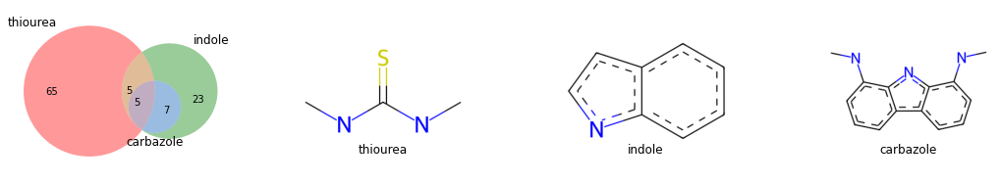

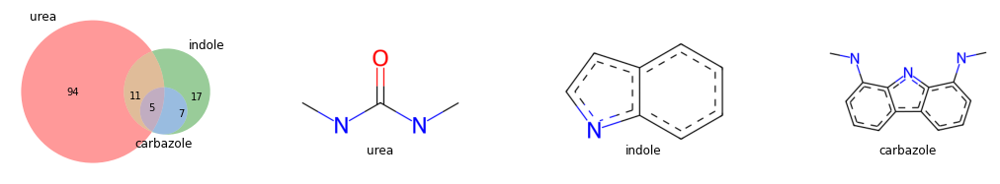

In [48]:
# Find overlap between 2 sets of molecules with different substructure patterns
result_intersect3 = []
for i in range(n_substructure-2):
    for j in range(n_substructure-1):
        for k in range(n_substructure):
            if k > j > i:
                intersect_i = substructure_set_list[i].intersection(substructure_set_list[j], substructure_set_list[k])
                #print('Intersect b/t ' + 
                #      substructure_name_list[i] +' and ' + 
                #      substructure_name_list[j] +' and ' + 
                #      substructure_name_list[k] + ': ' + str(len(intersect_i)) + '\n')
                result_intersect3.append(intersect_i)
                if len(intersect_i) != 0:
                    im_i = Chem.Draw.MolToImage(substructure_core_list[i])
                    im_j = Chem.Draw.MolToImage(substructure_core_list[j])
                    im_k = Chem.Draw.MolToImage(substructure_core_list[k])
                    
                    
                    fig, ax = plt.subplots(1,4, figsize = (15, 3))
                    plt.tight_layout()
                    
                    v = venn3([substructure_set_list[i], substructure_set_list[j], substructure_set_list[k]], 
                           (substructure_name_list[i], substructure_name_list[j], substructure_name_list[k]), 
                              ax = ax[0])
                    
                    ax[1].imshow(im_i)
                    ax[1].axis('off')
                    ax[1].set_title(substructure_name_list[i], y=0.1)

                    ax[2].imshow(im_j)
                    ax[2].axis('off')
                    ax[2].set_title(substructure_name_list[j], y=0.1)
                    
                    ax[3].imshow(im_k)
                    ax[3].axis('off')
                    ax[3].set_title(substructure_name_list[k], y=0.1)
                    
                    fig_name = 'fig_venn3_overlap_' + substructure_name_list[i] + '_' + substructure_name_list[j] + '_' + substructure_name_list[k] + '.png'
                    plt.savefig(fig_name)
                    
                    plt.show()
                    

In [49]:
venn2

<function matplotlib_venn._venn2.venn2(subsets, set_labels=('A', 'B'), set_colors=('r', 'g'), alpha=0.4, normalize_to=1.0, ax=None, subset_label_formatter=None)>

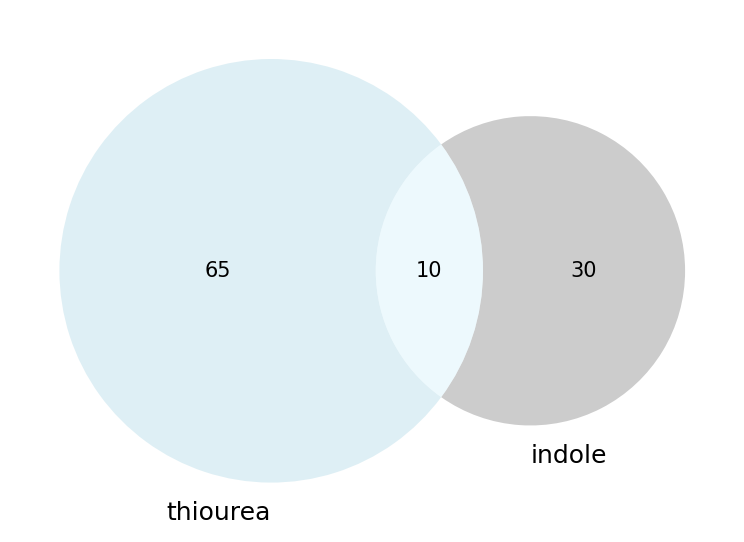

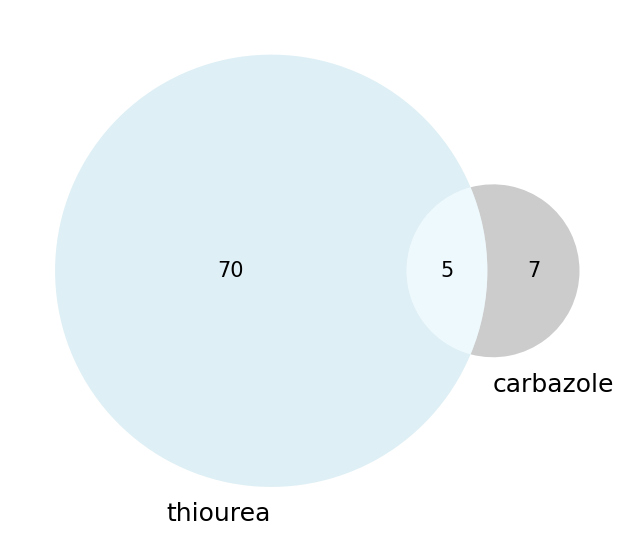

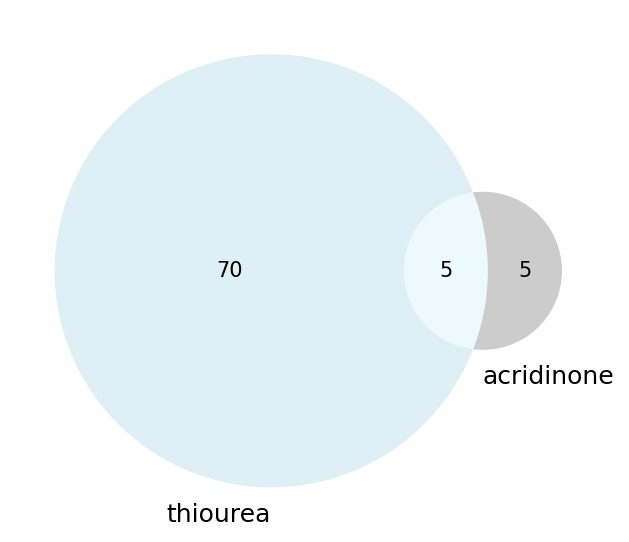

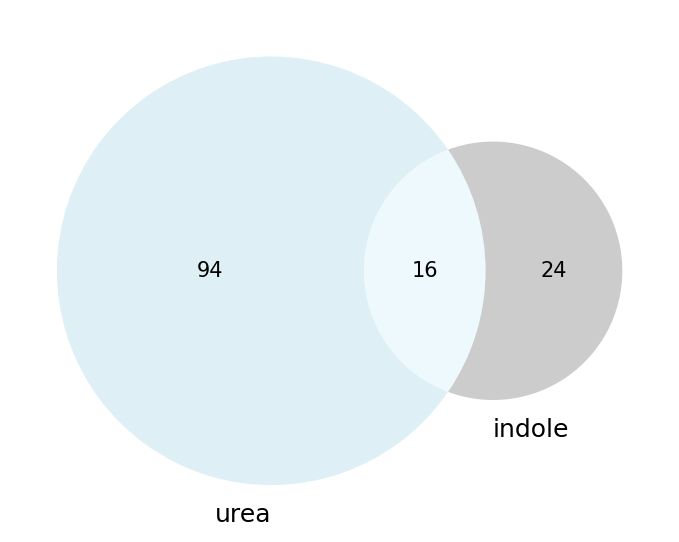

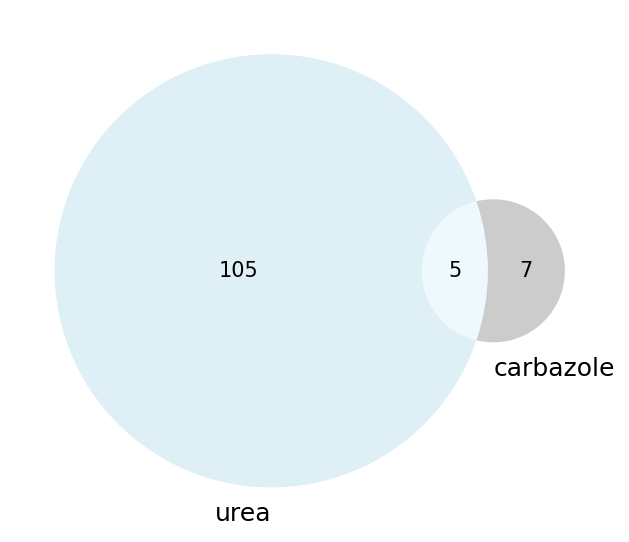

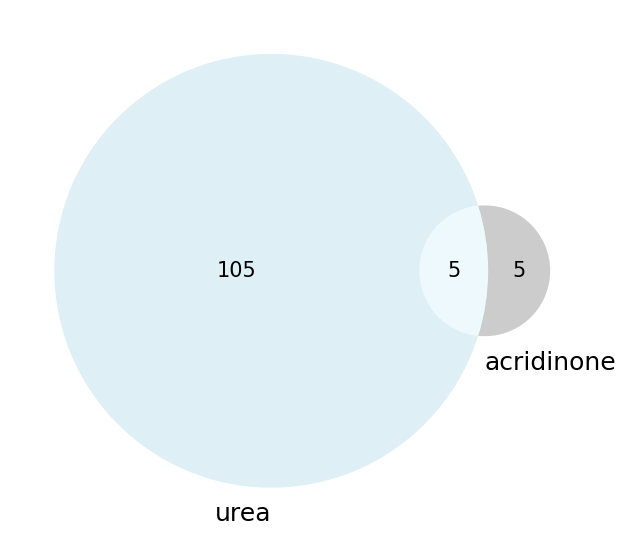

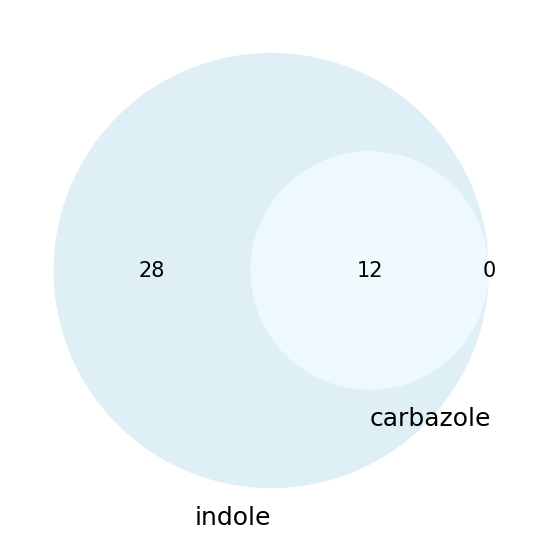

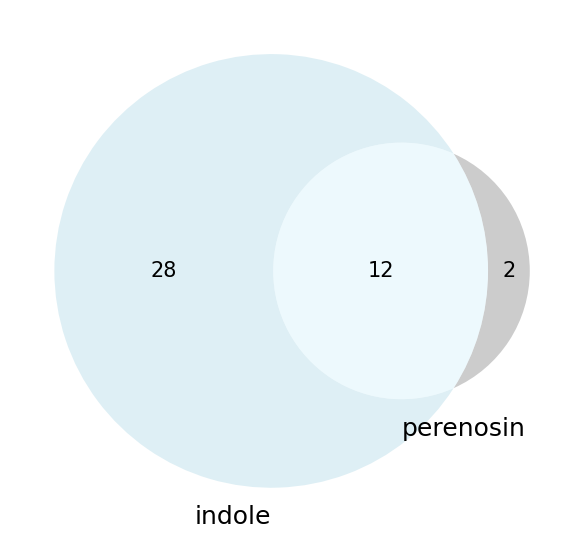

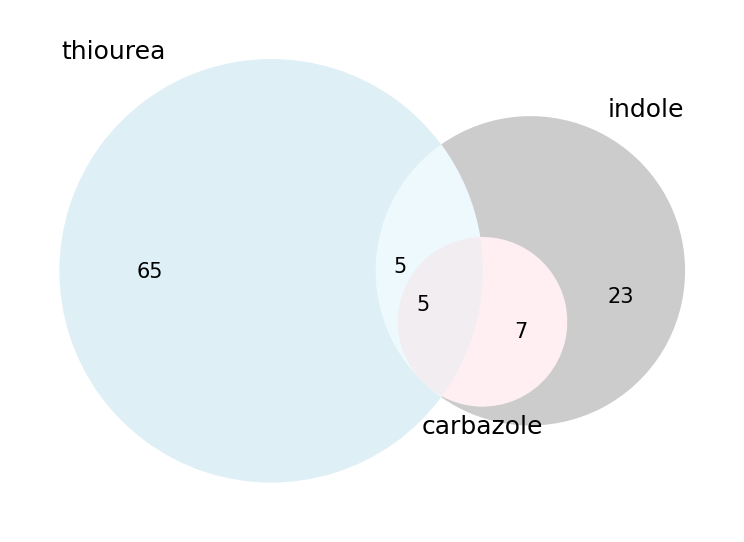

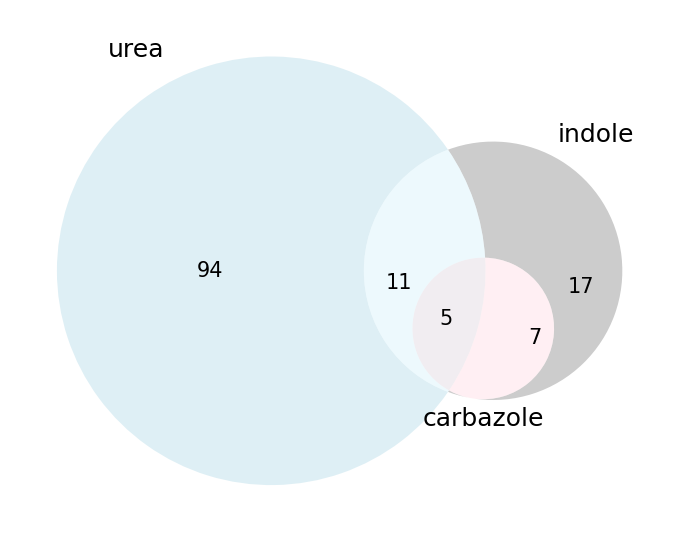

In [50]:
# Find overlap between 2 sets of molecules with different substructure patterns
result_intersect = []
for i in range(n_substructure-1):
    for j in range(n_substructure):
        if j > i:
            #print(i,j)
            intersect_i = substructure_set_list[i].intersection(substructure_set_list[j])
            result_intersect.append(intersect_i)
            if len(intersect_i) != 0:
                
                im_i = Chem.Draw.MolToImage(substructure_core_list[i])
                im_j = Chem.Draw.MolToImage(substructure_core_list[j])
                
                mols_int = [Chem.MolFromSmiles(m) for m in intersect_i]
                mols_index = [(smiles_canonical.index(m)) for m in intersect_i]
                mols_paperid = [data['paperid'][m] for m in mols_index]
                mols_label = []
                for m in range(len(mols_index)):
                    lb = 'index' + str(mols_index[m]) + '_paperid' + str(mols_paperid[m])
                    mols_label.append(lb)
                im_overlap = Chem.Draw.MolsToGridImage(mols_int,molsPerRow=5, 
                                                       legends=[n for n in mols_label],
                                                       subImgSize=(800,800), returnPNG=False)
                
                im_name = 'fig_grid_overlap_' + substructure_name_list[i] + '_' + substructure_name_list[j] + '.png'
                im_overlap.save(im_name, figsize = (30, 20))
                
                
                fig, ax = plt.subplots(1,1,dpi=150)
                plt.tight_layout()
                
                v = venn2([substructure_set_list[i], substructure_set_list[j]], 
                       (substructure_name_list[i], substructure_name_list[j]), 
                       set_colors=('lightblue', 'grey'),
                          ax = ax)
                
                fig_name = 'fig_venn2_only_' + substructure_name_list[i] + '_' + substructure_name_list[j] + '.png'
                plt.savefig(fig_name)
                
                plt.show()


# Find overlap between 2 sets of molecules with different substructure patterns
result_intersect3 = []
for i in range(n_substructure-2):
    for j in range(n_substructure-1):
        for k in range(n_substructure):
            if k > j > i:
                intersect_i = substructure_set_list[i].intersection(substructure_set_list[j], substructure_set_list[k])
                #print('Intersect b/t ' + 
                #      substructure_name_list[i] +' and ' + 
                #      substructure_name_list[j] +' and ' + 
                #      substructure_name_list[k] + ': ' + str(len(intersect_i)) + '\n')
                result_intersect3.append(intersect_i)
                if len(intersect_i) != 0:
                    im_i = Chem.Draw.MolToImage(substructure_core_list[i])
                    im_j = Chem.Draw.MolToImage(substructure_core_list[j])
                    im_k = Chem.Draw.MolToImage(substructure_core_list[k])
                    
                    
                    fig, ax = plt.subplots(1,1, dpi=150)
                    plt.tight_layout()
                    
                    v = venn3([substructure_set_list[i], substructure_set_list[j], substructure_set_list[k]], 
                           (substructure_name_list[i], substructure_name_list[j], substructure_name_list[k]), 
                           set_colors=('lightblue', 'grey', 'lightpink'),
                              ax = ax)
                    
                    fig_name = 'fig_venn3_only_' + substructure_name_list[i] + '_' + substructure_name_list[j] + '_' + substructure_name_list[k] + '.png'
                    plt.savefig(fig_name)
                    
                    plt.show()
                    
                

# Tanimoto similarity on all data


mean:  0.20957375648889925
std:  0.14525681851789202


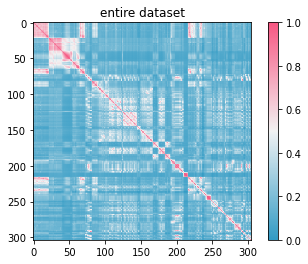

In [51]:
fps = [AllChem.GetMorganFingerprint(m,2) for m in mols]

# the list for the dataframe
qu, ta, sim = [], [], []
qu_n, ta_n = [], []

# compare all fp pairwise without duplicates
for n in range(len(fps)-1): # -1 so the last fp will not be used
    s = DataStructs.BulkTanimotoSimilarity(fps[n], fps[n+1:]) # +1 compare with the next to the last fp
    #print(smiles_list[n], smiles_list[n+1:]) # witch mol is compared with what group

    # collect the SMILES and values
    for m in range(len(s)):
        qu_n.append(n)
        ta_n.append(m)
        qu.append(smiles_canonical[n])
        ta.append(smiles_canonical[n+1:][m])
        sim.append(s[m])
print()

# build the dataframe and sort it
d = {'query':qu, 'target':ta, 'Similarity':sim}
df_final = pd.DataFrame(data=d)
#df_final = df_final.sort_values('Similarity', ascending=False)
#print(df_final)

dlabel = {'query':qu_n, 'target':ta_n, 'Similarity':sim}
df_label_final = pd.DataFrame(data=dlabel)


# save as csv
df_final.to_csv('fingerprints.csv', index=False, sep=',')
df_label_final.to_csv('fingerprints_label.csv', index=False, sep=',')

# visualize structural similarity
similarity_array = np.zeros(shape=(len(fps), len(fps)))

# compare all fp pairwise without duplicates
for n, fp in enumerate(fps): # -1 so the last fp will not be used
    s = DataStructs.BulkTanimotoSimilarity(fp, fps)
    similarity_array[n, :] = np.array(s)

    #s = DataStructs.BulkTanimotoSimilarity(fps[n], fps[n+1:]) # +1 compare with the next to the last fp
    #print(s)
    #print(smiles_list[n], smiles_list[n+1:]) # witch mol is compared with what group

# print mean and std of the similarity array
print('mean: ', np.mean(similarity_array))
print('std: ', np.std(similarity_array))

im = plt.imshow(similarity_array,cmap=sns.diverging_palette(230, 0, 90, 60, as_cmap=True))
plt.title('entire dataset')
plt.colorbar(im, spacing = 'uniform')
plt.clim(0, 1)
plt.savefig('fig_similarity.png', dpi=800)
plt.show()

# Tanimoto similarity in each substructure sets

In [48]:
# Convert list of RDKit molecules to list to morgan fingerprints
matches_thiourea_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_thiourea]
matches_urea_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_urea]
matches_squara_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_squara]
matches_indole_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_indole]
matches_tamb_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_tamb]
matches_carbazole_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_carbazole]
matches_acridinone_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_acridinone]
matches_pere_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_pere]
matches_BBP_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_BBP]
matches_isop_dipico_fps = [AllChem.GetMorganFingerprint(m,2) for m in matches_isop_dipico]

# List of lists of fps with each substructure pattern
substructure_fps_list = [matches_thiourea_fps, 
                         matches_urea_fps, 
                         matches_squara_fps, 
                         matches_indole_fps, 
                         matches_tamb_fps, 
                         matches_carbazole_fps, 
                         matches_acridinone_fps, 
                         matches_pere_fps,
                         matches_BBP_fps, 
                         matches_isop_dipico_fps]

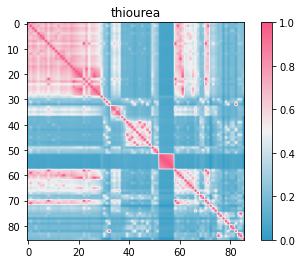

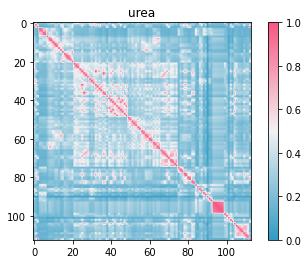

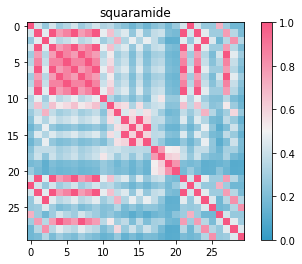

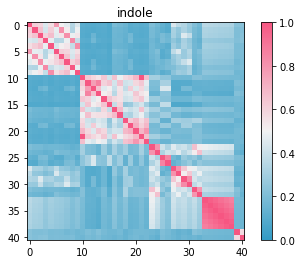

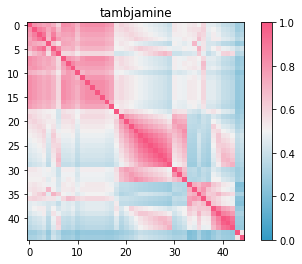

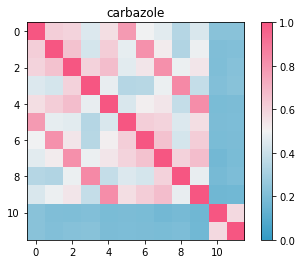

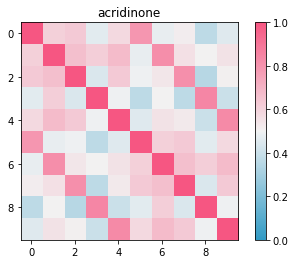

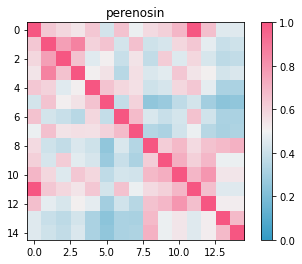

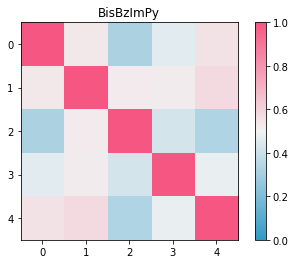

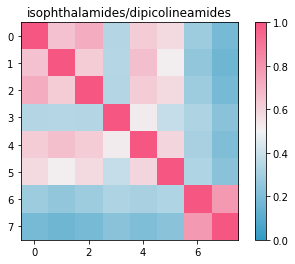

In [49]:
for i in range(n_substructure):
    fps = substructure_fps_list[i]
    similarity_array = np.zeros(shape=(len(fps), len(fps)))

    # compare all fp pairwise without duplicates
    for n, fp in enumerate(fps): # -1 so the last fp will not be used
        s = DataStructs.BulkTanimotoSimilarity(fp, fps)
        similarity_array[n, :] = np.array(s)
    
    im = plt.imshow(similarity_array,cmap=sns.diverging_palette(230, 0, 90, 60, as_cmap=True))
    plt.colorbar(im, spacing = 'uniform')
    plt.clim(0, 1)
    plt.title(substructure_name_list[i])
    
    fig_name = 'fig_similarity_' + substructure_name_list[i][:4] + '.png'
    plt.savefig(fig_name, dpi=800)
    plt.show()

# Split dataset to substructure dataset

In [277]:
mols = [Chem.MolFromSmiles(smi) for smi in smiles_canonical]

In [278]:
substructure_mol_list = [matches_thiourea, 
                         matches_urea, 
                         matches_squara, 
                         matches_indole, 
                         matches_tamb, 
                         matches_carbazole, 
                         matches_acridinone, 
                         matches_pere,
                         matches_BBP, 
                         matches_isop_dipico]

In [279]:
import itertools

substructure_mol_list_flat = list(itertools.chain(*substructure_mol_list))

In [285]:
# convert list of RDKit molecules to list to SMILES

substructure_smi_list_flat = [Chem.MolToSmiles(m) for m in substructure_mol_list_flat]

In [286]:
nomatch = []
for m in smiles_canonical:
    if m not in substructure_smi_list_flat:
        nomatch.append(m)
print(len(nomatch))

0


In [287]:
# Disctionary: substructure pattern : list of RDKit molecules
substructure_dict = {'thiourea': matches_thiourea, 
                     'urea': matches_urea, 
                     'squaramide': matches_squara, 
                     'indole': matches_indole, 
                     'tambjamine': matches_tamb, 
                     'carbazole': matches_carbazole, 
                     'acridinone': matches_acridinone, 
                     'perenosin': matches_pere,
                     'BisBzImPy': matches_BBP, 
                     'isophthalamides/dipicolineamides': matches_isop_dipico}

In [288]:
print('Substructure', '#molecules')
for n, l in substructure_dict.items():
    print(n, len(l))
    substructure_set = set(l)

Substructure #molecules
thiourea 86
urea 113
squaramide 30
indole 41
tambjamine 45
carbazole 12
acridinone 10
perenosin 15
BisBzImPy 5
isophthalamides/dipicolineamides 8


# Save to csv

In [259]:
data['mol'] = mols

In [292]:
data['canonical_smiles'] = smiles_canonical

In [294]:
df = data.copy()
for n, l in substructure_dict.items():
    name = str(n.replace('/','_'))

    l_smi = [Chem.MolToSmiles(m) for m in l]

    df[name] = np.where(df["canonical_smiles"].isin(l_smi), "1", "0")

filename = 'df_all_substructure_onehot.csv'.format(name)
df.to_csv(filename)

In [295]:
df

,entry_in_paper,smiles,anion,binding_mode\n(transporter),binding_mode\n(anion),stochiometry\n(#_of_anion_\nper_transporter),nmr_solvent,ka_(_m-1),unnamed:_8,log(ka),...,thiourea,urea,squaramide,indole,tambjamine,carbazole,acridinone,perenosin,BisBzImPy,isophthalamides_dipicolineamides
0,1,S=C(NCCCCCC)NC1=CC=C(Br)C=C1,Cl,1.0,1.0,1.0,DMSO,18.62,NaN,1.27,...,1,0,0,0,0,0,0,0,0,0
1,2,S=C(NCCCCCC)NC1=CC=C(C(F)(F)F)C=C1,Cl,1.0,1.0,1.0,DMSO,26.30,NaN,1.42,...,1,0,0,0,0,0,0,0,0,0
2,3,S=C(NCCCCCC)NC1=CC=C(Cl)C=C1,Cl,1.0,1.0,1.0,DMSO,19.95,NaN,1.30,...,1,0,0,0,0,0,0,0,0,0
3,4,S=C(NCCCCCC)NC1=CC=C(C#N)C=C1,Cl,1.0,1.0,1.0,DMSO,31.62,NaN,1.50,...,1,0,0,0,0,0,0,0,0,0
4,5,S=C(NCCCCCC)NC1=CC=C(C(C(F)(F)F)=O)C=C1,Cl,1.0,1.0,1.0,DMSO,41.69,NaN,1.62,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
299,4,O=C1C(NC2=CC(C(C)(C)C)=CC(C(C)(C)C)=C2)=C(NC3=...,Cl,1.0,1.0,1.0,DMSO,145,NaN,NaN,...,0,0,1,0,0,0,0,0,0,0
300,5,S=C1C(NC2=CC=CC=C2)=C(NC3=CC=CC=C3)C1=S,Cl,1.0,1.0,1.0,DMSO,270,NaN,NaN,...,0,0,1,0,0,0,0,0,0,0
301,6,S=C1C(NC2=CC=C(C(F)(F)F)C=C2)=C(NC3=CC=C(C(F)(...,Cl,1.0,1.0,1.0,DMSO,60,NaN,NaN,...,0,0,1,0,0,0,0,0,0,0
302,7,S=C1C(NC2=CC(C(F)(F)F)=CC(C(F)(F)F)=C2)=C(NC3=...,Cl,1.0,1.0,1.0,DMSO,NaN,NaN,NaN,...,0,0,1,0,0,0,0,0,0,0


In [296]:
for n, l in substructure_dict.items():
    l_smi = [Chem.MolToSmiles(m) for m in l]
    df = data[data['canonical_smiles'].isin(l_smi)]
    name = str(n.replace('/','_'))
    df.loc[:,['substructure']] = name
    filename = 'df_substructure_{}.csv'.format(name)
    df.to_csv(filename)

/var/folders/_g/b42gzqq15333k7_yvwzzfxzr0000gp/T/ipykernel_21624/3298804483.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:,['substructure']] = name
/var/folders/_g/b42gzqq15333k7_yvwzzfxzr0000gp/T/ipykernel_21624/3298804483.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:,['substructure']] = name
/var/folders/_g/b42gzqq15333k7_yvwzzfxzr0000gp/T/ipykernel_21624/3298804483.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc

# Target value distribution

In [65]:
data = pd.read_csv("../dataset_ise.csv", encoding='utf-8')
data.columns = ["_".join(ent.lower().strip().split(" ")) for ent in data.columns]
data['logec50'] = np.log10(data['ec50_/_mol%'])
smi_all = data['smiles']
target_all = data["logec50"]

In [102]:
def plot_hist(target, nbins = 10, title = 'entire dataset'):
    fig, ax = plt.subplots(figsize=(4, 4), dpi = 300)
    #fig = sns.distplot(target, hist=True, kde=True, bins = 80, color = 'blue', hist_kws={'edgecolor':'black'})
    
    ax = sns.histplot(target, bins = nbins,
                      color = 'darkblue', alpha=0.4,edgecolor=(1, 1, 1, .4),)
                      #kde=True, stat="density", kde_kws=dict(cut=3))
    ax.set_ylim(0,8)
    ax.set_xlim(-5,5)
    ax.set_xlabel('logEC$_{50}$')
    ax.set_title(title + ' (n = {})'.format(str(len(target))))
    
    filename = 'fig_y_histogram_' + title + '_n{}.png'.format(str(len(target)))
    
    fig.savefig(filename, dpi = 300)
    return

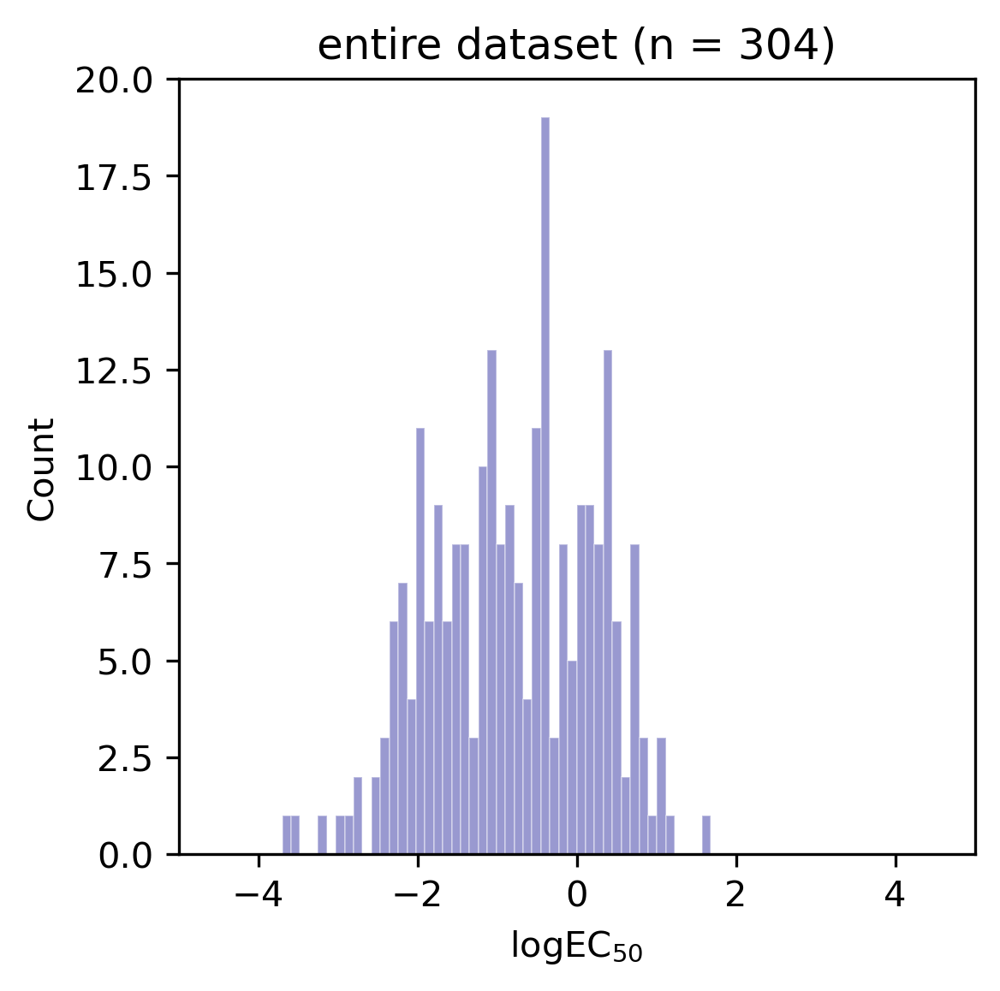

In [99]:
plot_hist(target_all, nbins = 48)

## Target distribution of each substructure

In [81]:
import os
from glob import glob

In [82]:
cwd = os.getcwd()
csvfiles = glob(os.path.join(cwd, 'df_substructure*csv'))

In [83]:
name_list = []
df_list = []
smi_list = []
target_list = []

for i in range(len(csvfiles)):
    file = csvfiles[i]
    
    name = os.path.split(file)[-1][:-4].replace('df_', '')
    name_list.append(name)
    
    df = pd.read_csv(file, encoding='utf-8')
    df_list.append(df)
    
    smi = df['smiles']
    smi_list.append(smi)   
    
    df['logec50'] = np.log10(df['ec50_/_mol%'])
    targets = df['logec50']
    target_list.append(targets)
    
    print(name, len(targets))

substructure_carbazole 12
substructure_isophthalamides_dipicolineamides 8
substructure_urea 113
substructure_acridinone 10
substructure_squaramide 30
substructure_indole 41
substructure_thiourea 86
substructure_perenosin 15
substructure_tambjamine 45
substructure_BisBzImPy 5


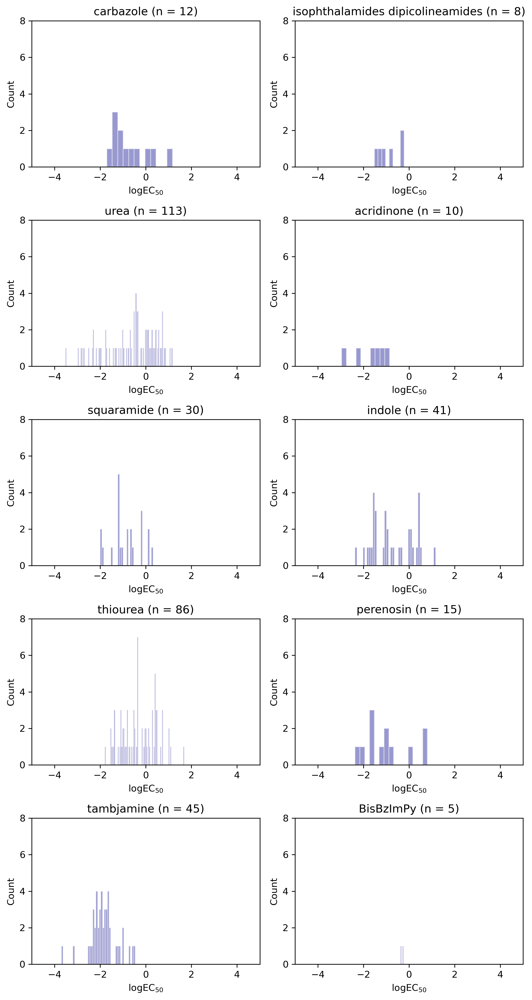

In [93]:
fig, ax = plt.subplots(5, 2, figsize=(8,15), dpi = 300)

for i in range(len(target_list)):
    t = target_list[i]
    name = name_list[i]
    
    b = int(t.shape[0])

    ax[i//2, i%2].hist(t, bins = b, color = 'darkblue', alpha=.4, edgecolor=(1, 1, 1, .4))
    ax[i//2, i%2].set_ylim(0, 8)
    ax[i//2, i%2].set_xlim(-5,5)
    ax[i//2, i%2].set_xlabel('logEC$_{50}$')
    ax[i//2, i%2].set_title(name.replace('substructure_', '').replace('_',' ') + ' (n = {})'.format(str(b)))
    ax[i//2, i%2].set_ylabel('Count')
    
    

fig.tight_layout()
fig.savefig('fig_y_histogram_substructure.png', dpi=300)

plt.show()


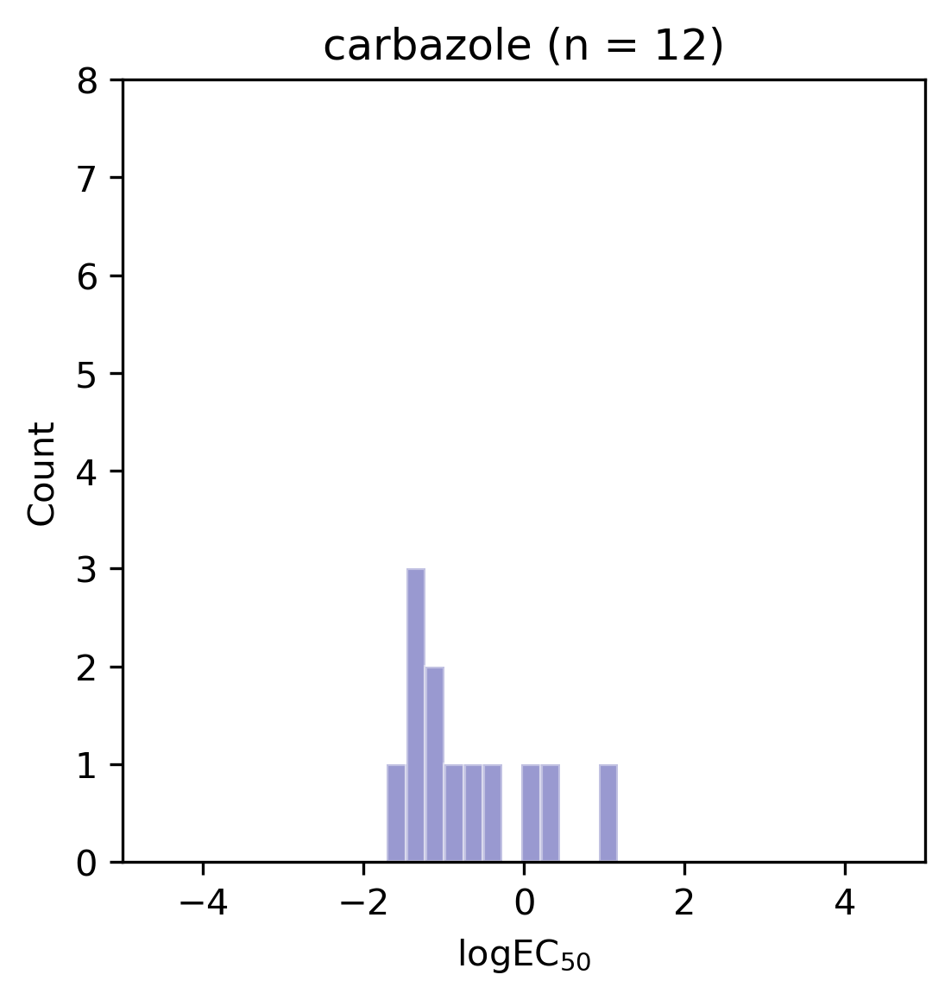

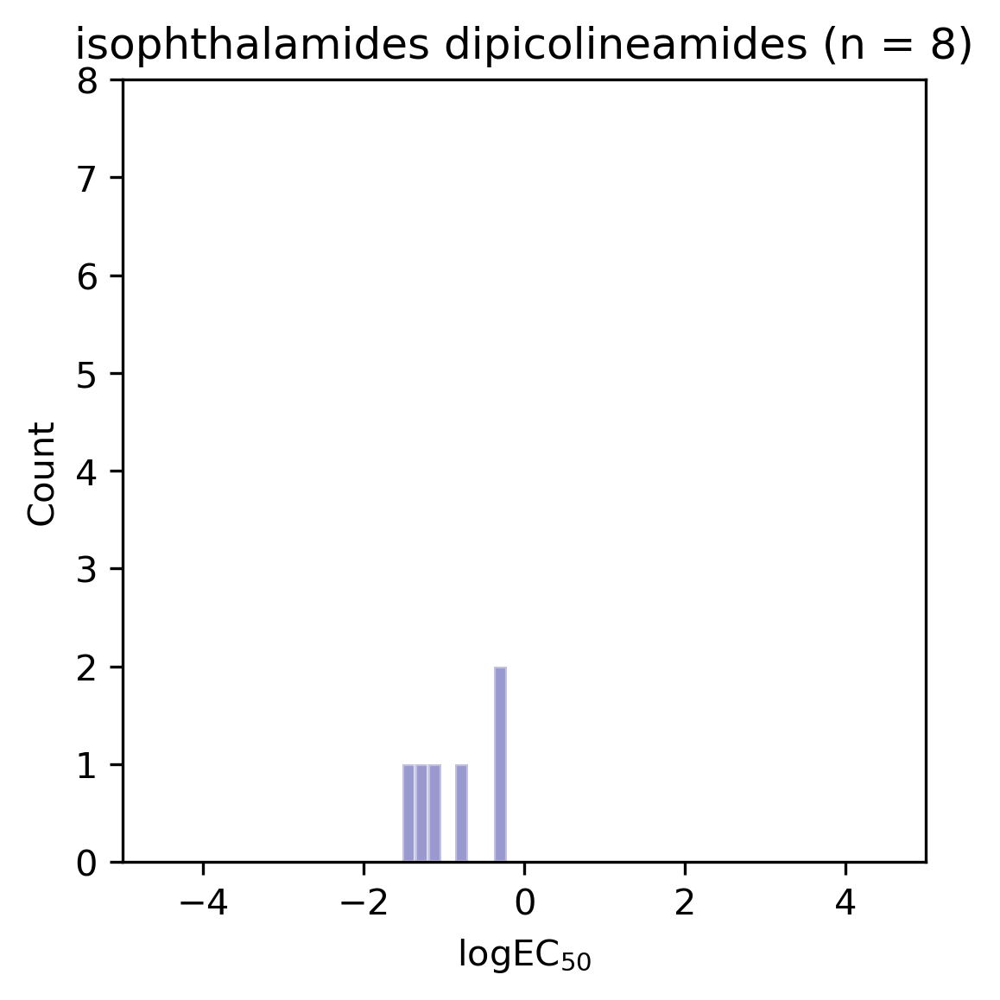

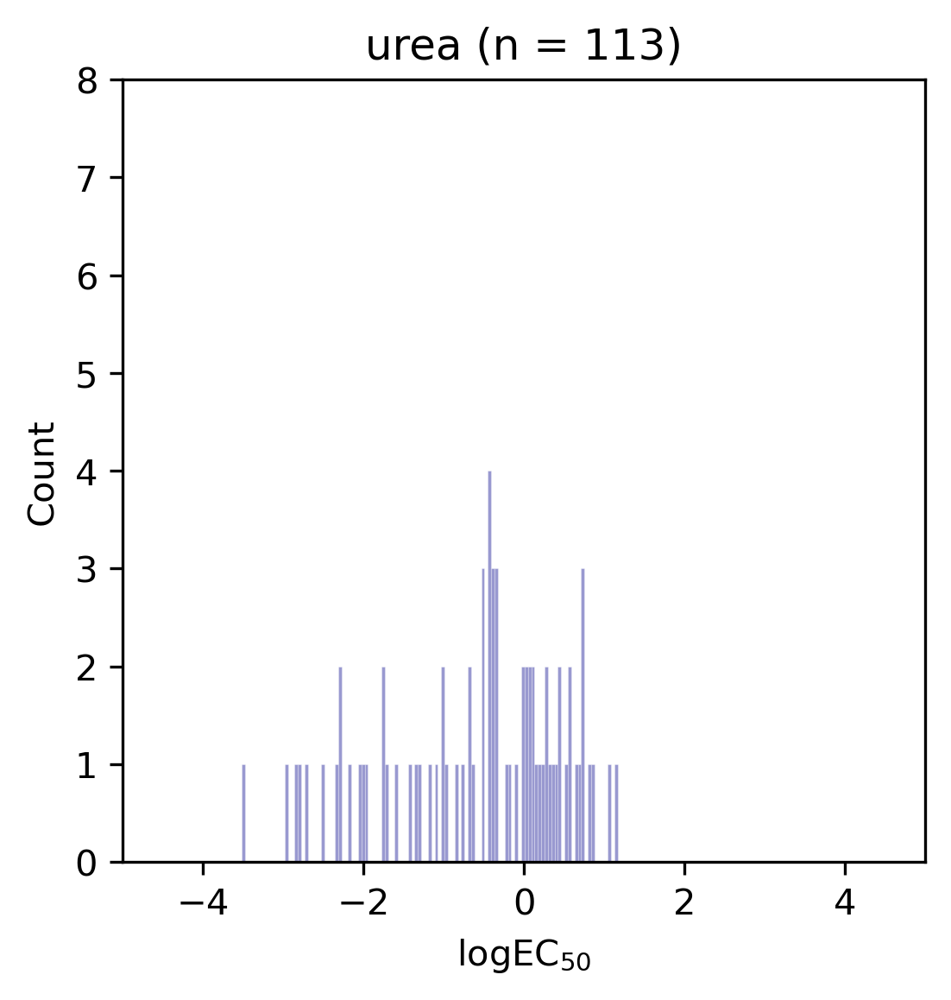

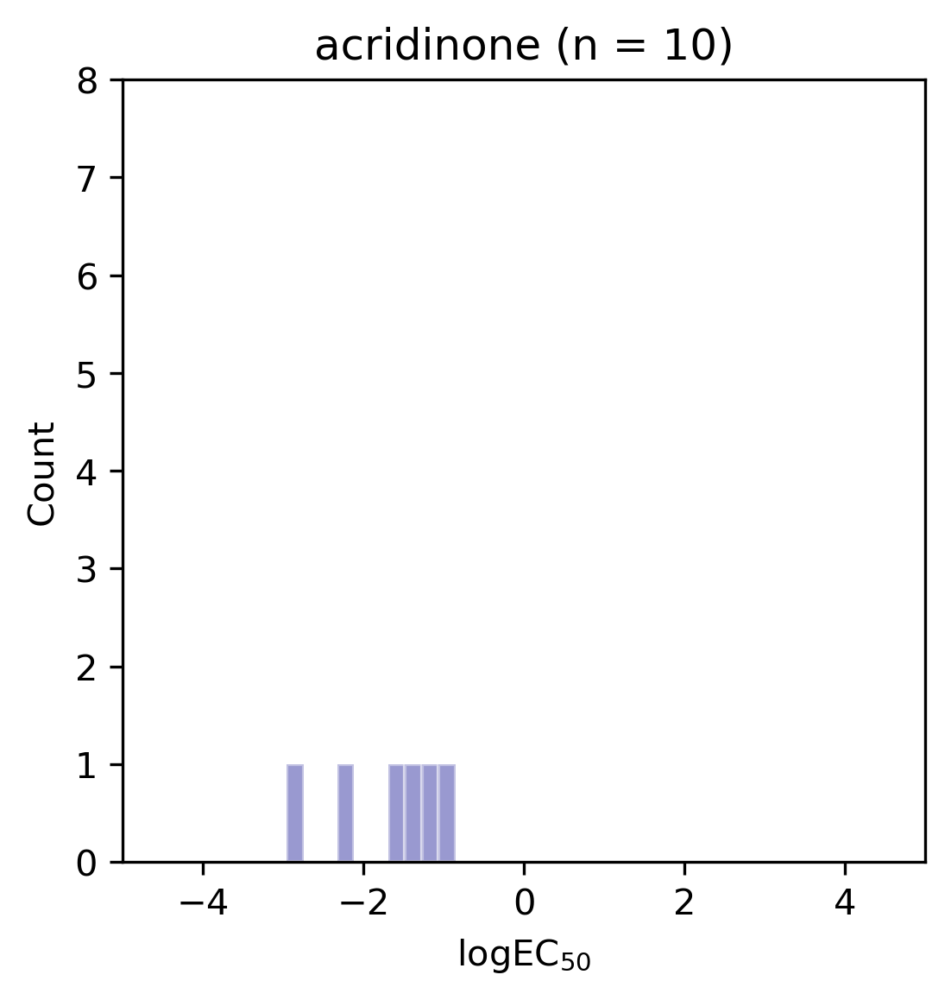

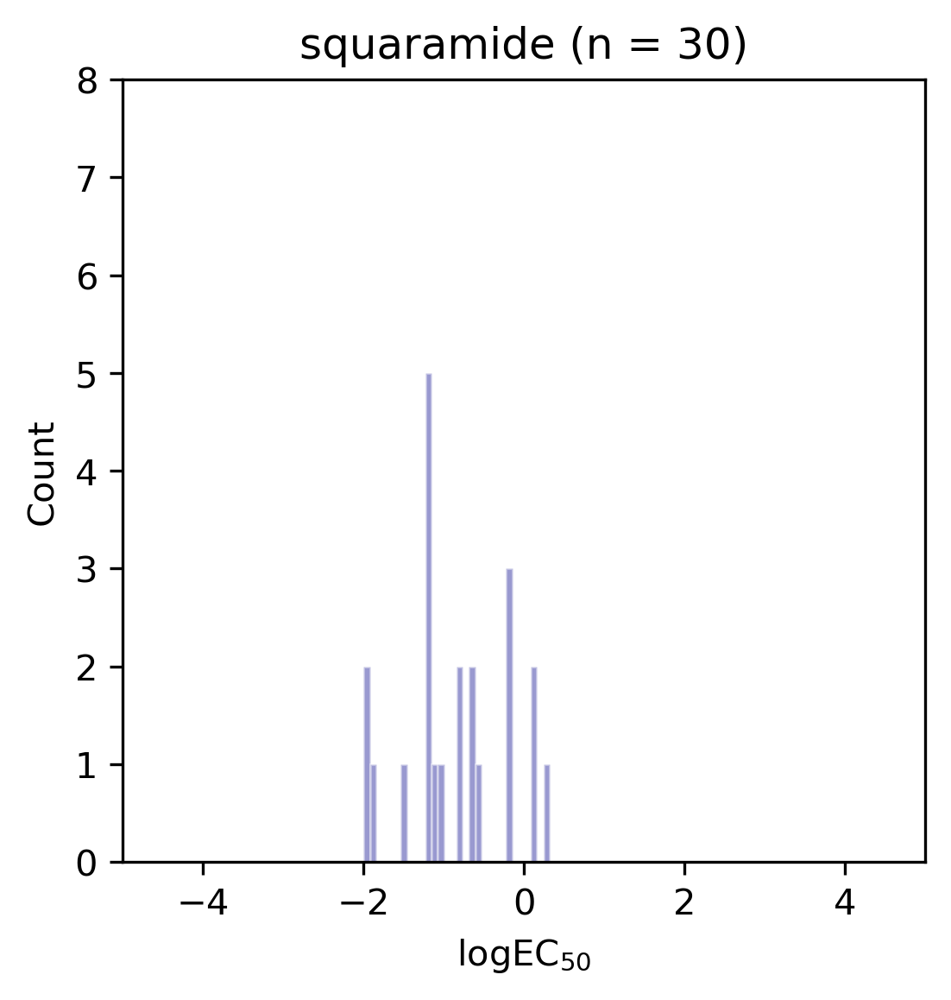

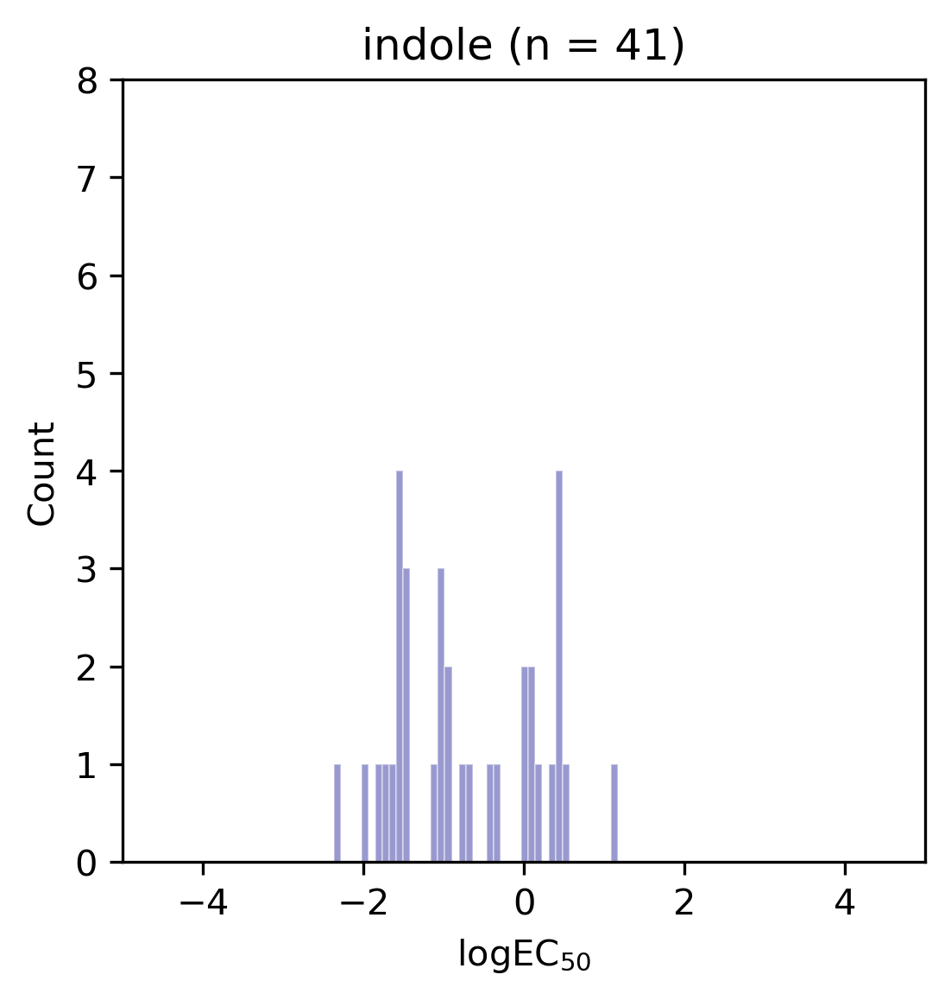

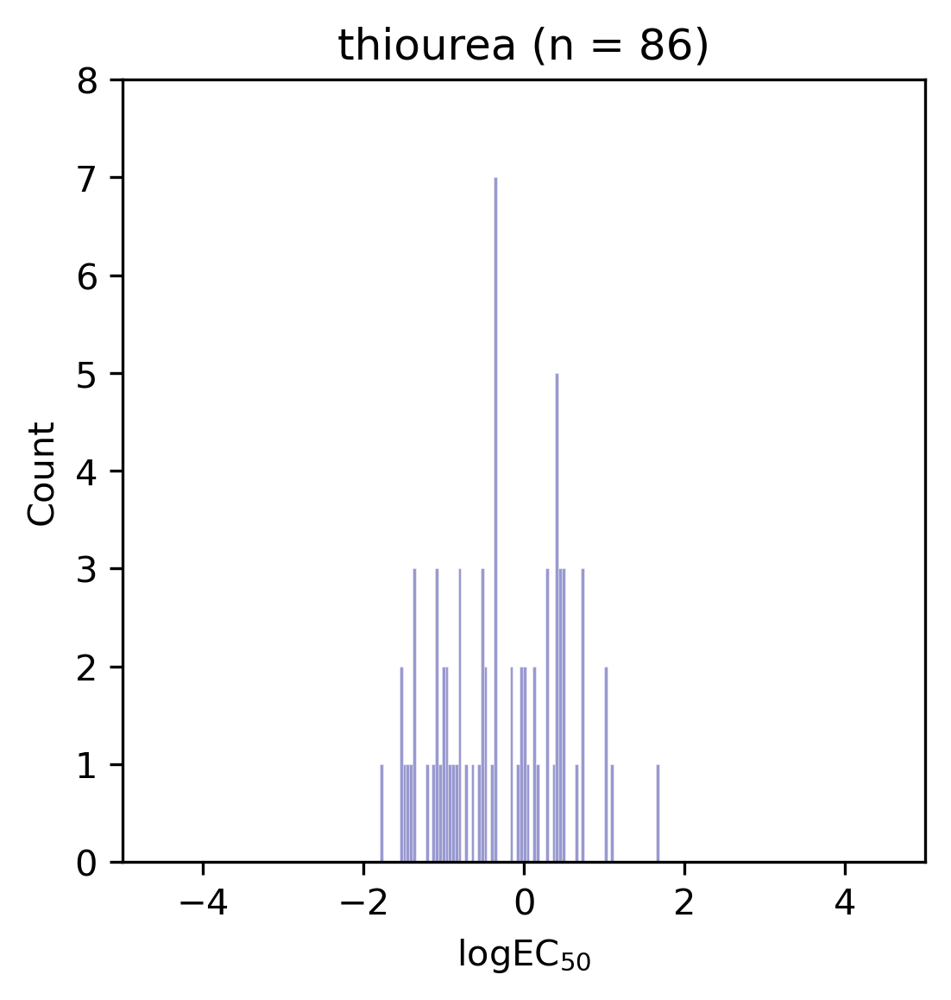

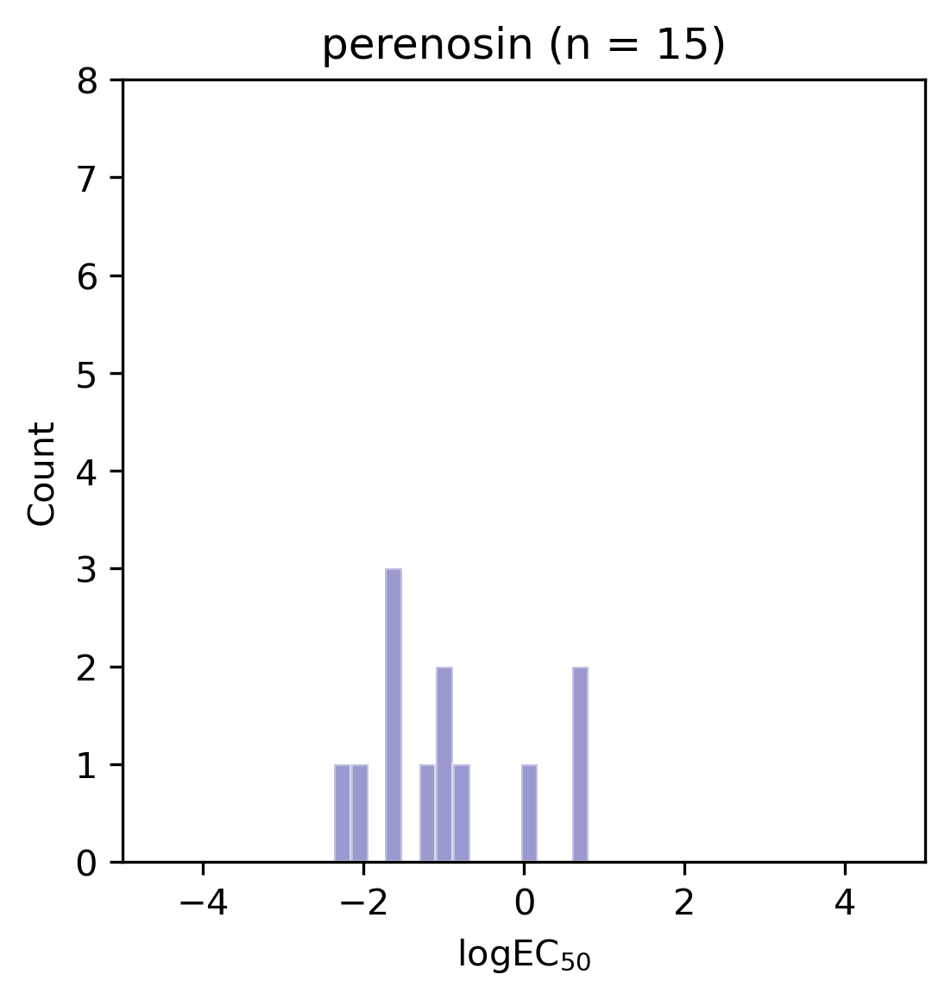

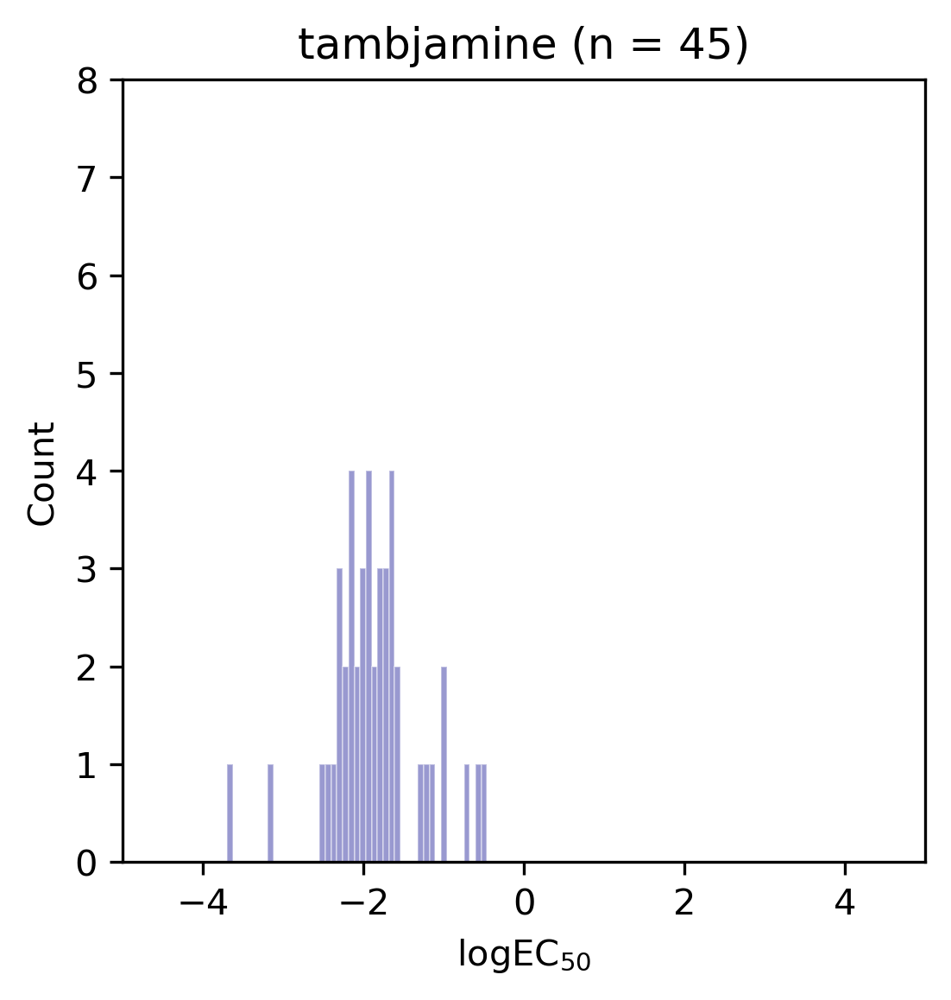

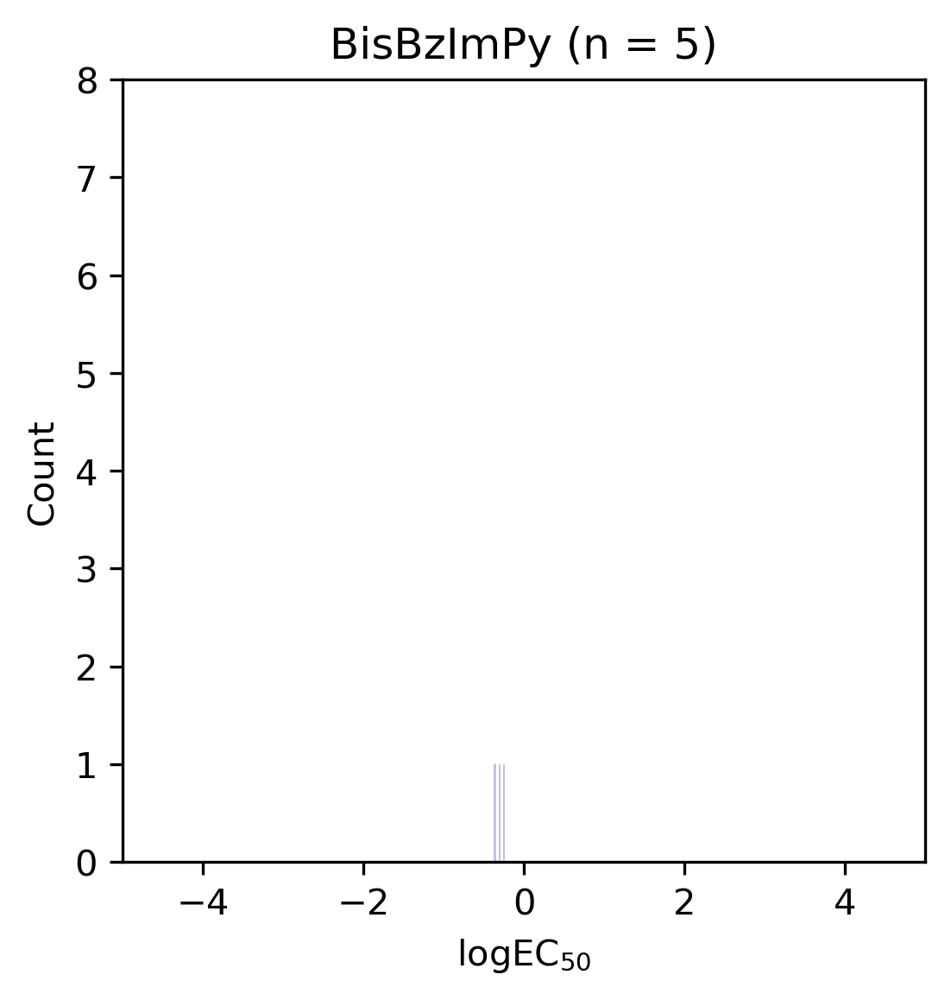

In [103]:
for i in range(len(target_list)):
    t = target_list[i]
    name = name_list[i]
    
    b = int(t.shape[0])
        
    plot_hist(t, nbins = b, title = str(name).replace('substructure_', '').replace('_',' '))

# Classify target value

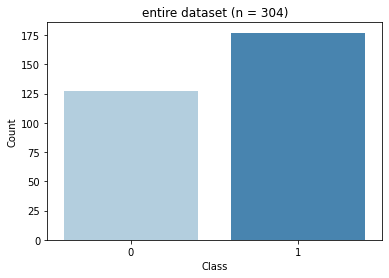

In [387]:
# if logEC50 < 0, class 1
# if logEC50 >= 0, class 0

# plot for entire dataset
data['class'] = np.where(data['logec50'] < 0, 1, 0)
data['class'].value_counts()

fig, ax = plt.subplots()
sns.countplot(x = 'class', data = data, palette = 'Blues')
ax.set_xlabel('Class')
ax.set_ylabel('Count')
ax.set_xticklabels(['0', '1'])
ax.set_title('entire dataset (n = {})'.format(str(len(data))))
fig.savefig('fig_y_class_entire_dataset.png', dpi=300)

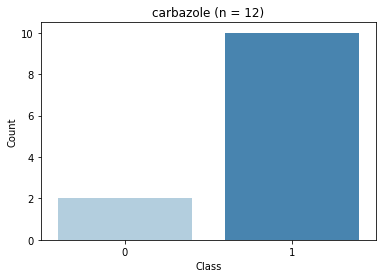

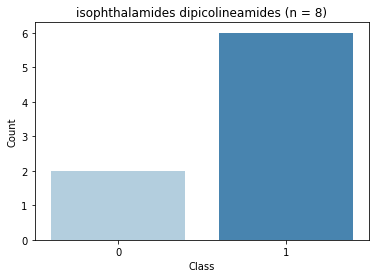

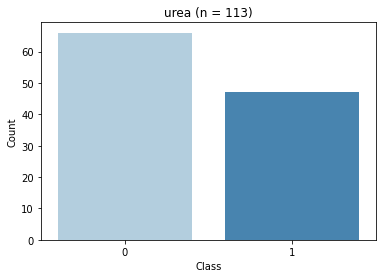

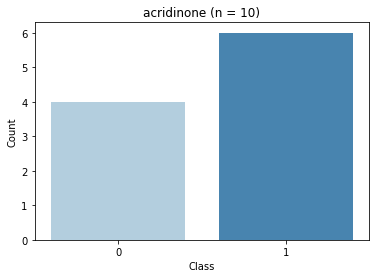

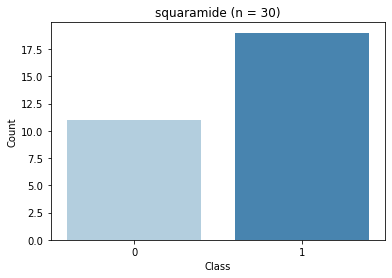

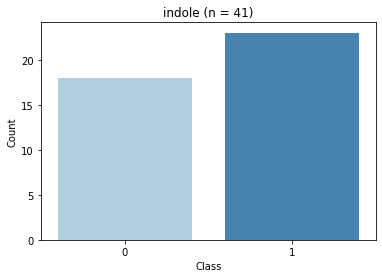

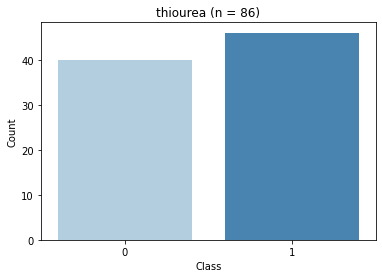

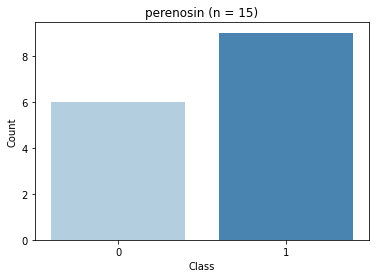

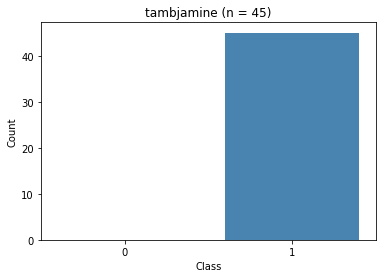

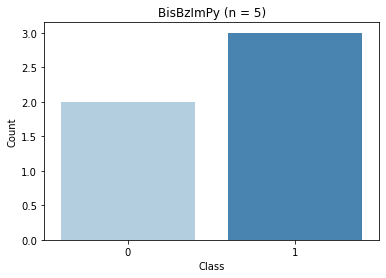

In [382]:
# plot for each substructure dataset
for i in range(len(target_list)):
    t = target_list[i]
    name = name_list[i]
    
    df = df_list[i]
    
    df['class'] = np.where(df['logec50'] < 0, 1, 0)
    df['class'].value_counts()
    
    fig, ax = plt.subplots()

    # show class 0 first
    # show the bar even if there is no data
    sns.countplot(x = 'class', data = df, palette = 'Blues', order = [0,1])
    ax.set_xlabel('Class')
    ax.set_ylabel('Count')
    ax.set_xticklabels(['0', '1'])
    ax.set_title(name.replace('substructure_', '').replace('_',' ') + ' (n = {})'.format(str(len(df))))
    fig.savefig('fig_y_class_{}.png'.format(name), dpi=300)
    

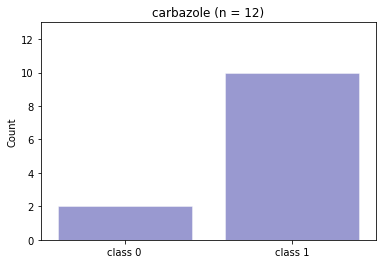

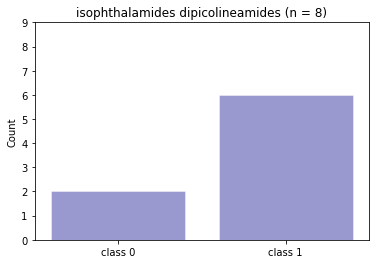

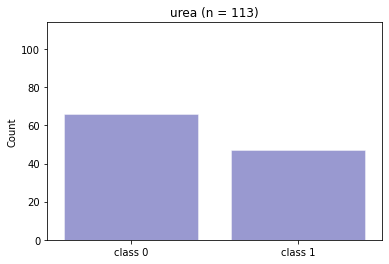

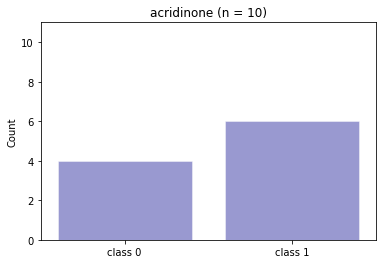

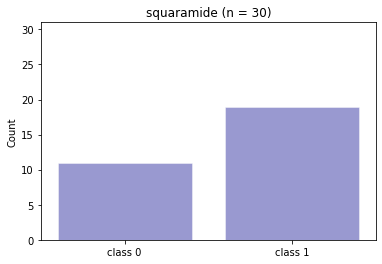

...

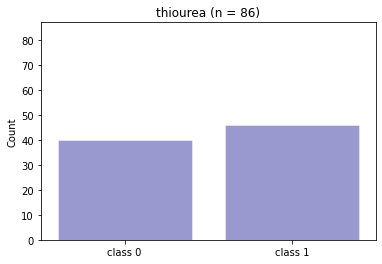

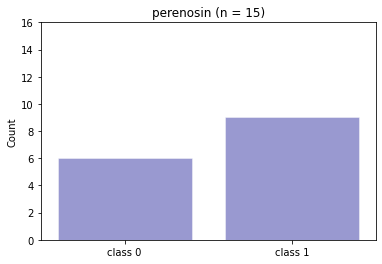

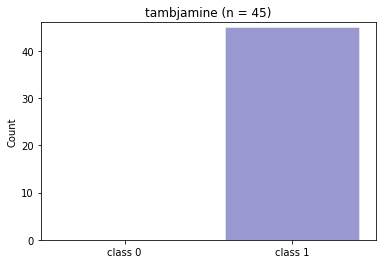

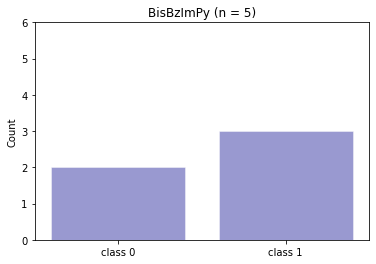

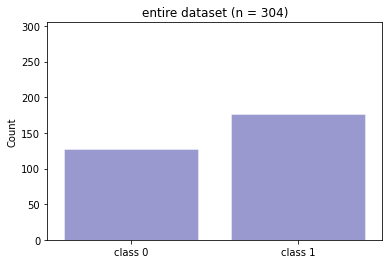

In [386]:
# if logEC50 < 0, class 1
# if logEC50 >= 0, class 0

for i in range(len(target_list)):
    t = target_list[i]
    name = name_list[i]
    
    b = int(t.shape[0])
    
    t_class = np.where(t < 0, 1, 0)
    
    fig, ax = plt.subplots()
    ax.bar([0,1], [np.sum(t_class == 0), np.sum(t_class == 1)], color = 'darkblue', alpha=.4, edgecolor=(1, 1, 1, .4))
    ax.set_ylim(0, np.max(len(t_class)+1))
    ax.set_xlim(-0.5,1.5)
    ax.set_xticks([0,1])
    ax.set_xticklabels(['class 0', 'class 1'])
    ax.set_title(name.replace('substructure_', '').replace('_',' ') + ' (n = {})'.format(str(b)))
    ax.set_ylabel('Count')

    
    filename = 'fig_y_class_histogram_' + name + '_n{}.png'.format(str(b))
    
    fig.savefig(filename, dpi = 300)

# plot for entire dataset
data['class'] = np.where(data['logec50'] < 0, 1, 0)
data['class'].value_counts()

fig, ax = plt.subplots()
ax.bar([0,1], [np.sum(data['class'] == 0), np.sum(data['class'] == 1)], color = 'darkblue', alpha=.4, edgecolor=(1, 1, 1, .4))
ax.set_ylim(0, np.max(len(data['class'])+1))
ax.set_xlim(-0.5,1.5)
ax.set_xticks([0,1])
ax.set_xticklabels(['class 0', 'class 1'])
ax.set_title('entire dataset (n = {})'.format(str(len(data))))
ax.set_ylabel('Count')
fig.savefig('fig_y_class_histogram_entire_dataset.png', dpi=300)
